<a href="https://colab.research.google.com/github/Apucs/Convolutional-Neural-Networks/blob/master/MultistageObjectDetection(PyTorch).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# doesn't matter much :)
from google.colab import drive
drive.mount('/content/drive') #usg 45 for fine-tuning, usg 44 for classifier

Mounted at /content/drive


In [ ]:
!pip install efficientnet_pytorch   #for efficientnet backbone
!pip install torchmetrics
!pip install wandb

  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16446 sha256=fdd240a95dc2e8fd1415f0bae5173773f76bd316737c1a93959b93f867c89f45
  Stored in directory: /root/.cache/pip/wheels/0e/cc/b2/49e74588263573ff778da58cc99b9c6349b496636a7e165be6
Successfully built efficientnet-pytorch
     |████████████████████████████████| 282 kB 2.0 MB/s 
     |████████████████████████████████| 1.7 MB 4.3 MB/s 
     |████████████████████████████████| 180 kB 81.6 MB/s 
     |████████████████████████████████| 97 kB 8.5 MB/s 
     |████████████████████████████████| 139 kB 66.4 MB/s 
     |████████████████████████████████| 63 kB 2.2 MB/s 
  Created wheel for subprocess32: filename=subprocess32-3.5.4-py3-none-any.whl size=6502 sha256=e48047df48e1b2037bc11d5d69e5fefa888b55402b822c6d115d4afeb086ad58
  Stored in directory: /root/.cache/pip/wheels/50/ca/fa/8fca8d246e64f19488d07567547ddec8eb084e8c0d7a59226a
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab.patches import cv2_imshow # cv2.imshow for COLAB
#from cv2 import imshow as cv2_imshow # <--- use this for regular use.
import os
import re
import random
import time
import pickle

from skimage import io
import shutil
from tqdm import tqdm
import tarfile
import requests
import urllib.request
import xml.etree.ElementTree as ET
from PIL import Image
import wandb

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torchvision import datasets, models, transforms
from torchmetrics import Accuracy
from efficientnet_pytorch import EfficientNet

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

## Define HParams

In [ ]:
config={'image_size':224, 'n_classes':21, 'bbox_reg': True, 'network': 'efficientnet-b0', 'max_proposals':2000, 'pad': 16}
train_config={'log_wandb':True, 'logging': ['plot'],
              'epochs': 3, 'batch_size':128, 'lr': 0.001, 'lr_decay':0.5, 'l2_reg': 1e-5}
train_config_classifer={'log_wandb':True, 'logging': ['plot'],
              'epochs': 1, 'batch_size':128, 'lr': 0.001, 'lr_decay':0.5, 'l2_reg': 1e-5}

voc_2012_classes=['background','Aeroplane',"Bicycle",'Bird',"Boat","Bottle","Bus","Car","Cat","Chair",'Cow',"Dining table","Dog","Horse","Motorbike",'Person', "Potted plant",'Sheep',"Sofa","Train","TV/monitor"]

# Load data

In [ ]:
def ensure_dir(file_path):
    directory = os.path.dirname(file_path)
    if not os.path.exists(directory):
        os.makedirs(directory)

## Download data

In [ ]:
class VOCDataset():
  def __init__(self):
    self.train_dir=None
    self.test_dir=None
    self.trainDataLink=None
    self.testDataLink=None

    self.common_init()

  def common_init(self):
    # init that must be shared among all subclasses of this method
    self.label_type=['none','aeroplane',"Bicycle",'bird',"Boat","Bottle","Bus","Car","Cat","Chair",'cow',"Diningtable","Dog","Horse","Motorbike",'person', "Pottedplant",'sheep',"Sofa","Train","TVmonitor"]
    self.convert_id=['background','Aeroplane',"Bicycle",'Bird',"Boat","Bottle","Bus","Car","Cat","Chair",'Cow',"Dining table","Dog","Horse","Motorbike",'Person', "Potted plant",'Sheep',"Sofa","Train","TV/monitor"]
    self.convert_labels={}
    for idx, x in enumerate(self.label_type):
      self.convert_labels[x.lower()]=idx

    self.num_classes=len(self.label_type) # 20 + 1(none)

  def download_dataset(self, validation_size=5000):
    # download voc train dataset
    print('[*] Downloading dataset...')
    print(self.trainDataLink)
    urllib.request.urlretrieve(self.trainDataLink, 'voctrain.tar')

    print('[*] Extracting dataset...')
    tar = tarfile.open('voctrain.tar', "r:")
    tar.extractall('/content/VOCtrain')
    tar.close()
    os.remove('/content/voctrain.tar')

    if self.testDataLink is None: 
      # move 5K images to validation set
      print('[*] Moving validation data...')
      ensure_dir(self.test_dir+'/Annotations/')
      ensure_dir(self.test_dir+'/JPEGImages/')

      random.seed(42)
      val_images = random.sample(sorted(os.listdir(self.train_dir + '/JPEGImages')), validation_size)

      for path in val_images:
        img_name = path.split('/')[-1].split('.')[0]
        # move image
        os.rename(self.train_dir+'/JPEGImages/'+img_name+'.jpg', self.test_dir+'/JPEGImages/'+img_name+'.jpg')
        # move annotation
        os.rename(self.train_dir+'/Annotations/'+img_name+'.xml', self.test_dir+'/Annotations/'+img_name+'.xml')
    else: 
      # Load from val data
      print('[*] Downloading validation dataset...')
      urllib.request.urlretrieve(self.testDataLink, 'voctest.tar')

      print('[*] Extracting validation dataset...')
      tar = tarfile.open('voctest.tar', "r:")
      tar.extractall('/content/VOCtest')
      tar.close()
      os.remove('/content/voctest.tar')

  def read_xml(self, xml_path): 
    object_list=[]

    tree = ET.parse(open(xml_path, 'r'))
    root=tree.getroot()
  
    objects = root.findall("object")
    for _object in objects:
      name = _object.find("name").text
      bndbox = _object.find("bndbox")
      xmin = int(bndbox.find("xmin").text)
      ymin = int(bndbox.find("ymin").text)
      xmax = int(bndbox.find("xmax").text)
      ymax = int(bndbox.find("ymax").text)
      class_name = _object.find('name').text
      object_list.append({'x1':xmin, 'x2':xmax, 'y1':ymin, 'y2':ymax, 'class': self.convert_labels[class_name]})

    return object_list

In [ ]:
class VOC2007(VOCDataset):
  def __init__(self):
    self.train_dir='/content/VOCtrain/VOCdevkit/VOC2007'
    self.test_dir='/content/VOCtest/VOCdevkit/VOC2007'
    self.trainDataLink='http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtrainval_06-Nov-2007.tar'
    self.testDataLink='http://host.robots.ox.ac.uk/pascal/VOC/voc2007/VOCtest_06-Nov-2007.tar'
    self.common_init()#mandatory
    
class VOC2012(VOCDataset):
  def __init__(self):
    self.train_dir='/content/VOCtrain/VOCdevkit/VOC2012'
    self.test_dir='/content/VOCtest/VOCdevkit/VOC2012'
    # original site goes down frequently, so we use a link to the clone alternatively
    # self.trainDataLink='http://host.robots.ox.ac.uk/pascal/VOC/voc2012/VOCtrainval_11-May-2012.tar' 
    self.trainDataLink = 'http://pjreddie.com/media/files/VOCtrainval_11-May-2012.tar'
    self.testDataLink=None
    self.common_init()#mandatory

In [ ]:
voc_dataset=VOC2012()
voc_dataset.download_dataset()

[*] Downloading dataset...
http://pjreddie.com/media/files/VOCtrainval_11-May-2012.tar
[*] Extracting dataset...
[*] Moving validation data...


In [ ]:
val_datalen=len(os.listdir(voc_dataset.test_dir+'/Annotations'))
train_datalen=len(os.listdir(voc_dataset.train_dir+'/Annotations'))
print(train_datalen, val_datalen) # 17,125 total

12125 5000


## Demostrate

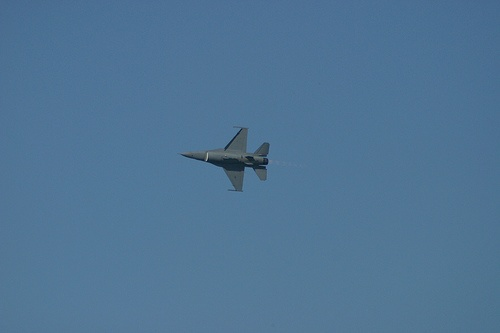

Shape: (333, 500, 3)


In [ ]:
img_name = sorted(os.listdir(voc_dataset.train_dir+'/JPEGImages'))[10][:-4]

img=cv2.imread(voc_dataset.train_dir+'/JPEGImages/'+img_name+'.jpg')
cv2_imshow(img)
print('Shape:', img.shape)

w, h: 500 333


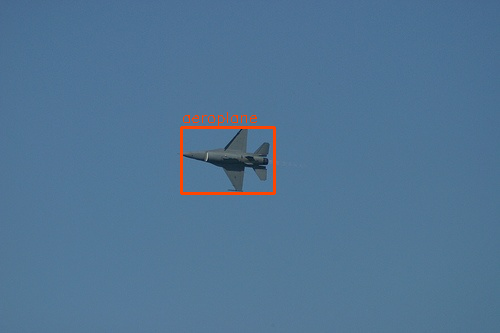

In [ ]:
# referenced code of https://deepbaksuvision.github.io/Modu_ObjectDetection/posts/02_01_PASCAL_VOC.html
xml_path=voc_dataset.train_dir+'/Annotations/'+img_name+'.xml'
tree = ET.parse(open(xml_path, 'r'))

root=tree.getroot()
# print image shape
w, h = root.find("size").find("width").text, root.find("size").find("height").text
print('w, h:', w, h)

# plot bounding boxes
box_im=img.copy()
bbox_color=(0, 69, 255) # (b, g, r) not (r, g, b)
bbox_thickness=2

font                   = cv2.FONT_HERSHEY_SIMPLEX
fontScale              = 0.5
fontColor              = bbox_color
lineType               = 1


objects = root.findall("object")
for _object in objects:
  name = _object.find("name").text
  bndbox = _object.find("bndbox")
  xmin = int(bndbox.find("xmin").text)
  ymin = int(bndbox.find("ymin").text)
  xmax = int(bndbox.find("xmax").text)
  ymax = int(bndbox.find("ymax").text)
  class_name = _object.find('name').text

  cv2.rectangle(box_im, (xmin, ymin), (xmax, ymax), bbox_color, bbox_thickness)
  cv2.putText(box_im, class_name, (xmin, ymin-5), font, 
    fontScale,
    fontColor,
    lineType)

cv2_imshow(box_im)

### Demonstrate selective search


Found 89 boxes...


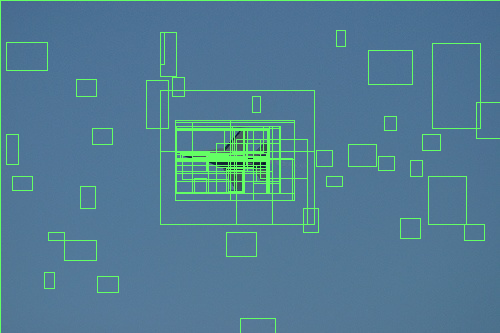

In [ ]:
# referenced from https://github.com/Hulkido/RCNN/blob/master/RCNN.ipynb
img_ss=img.copy()

ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
ss.setBaseImage(img_ss)
ss.switchToSelectiveSearchFast() # "... extract around 2000 region proposals (we use selective search’s “fast mode” in all experiments)."
rects = ss.process()


print('Found',len(rects),'boxes...')
for i, rect in (enumerate(rects)):
  if i>2000:
    break
  x, y, w, h = rect
  cv2.rectangle(img_ss, (x, y), (x+w, y+h), (100, 255, 100), 1)
    
cv2_imshow(img_ss)

# Helper functions


In [ ]:
def selective_search(image):
  # return region proposals of selective searh over an image
  ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
  ss.setBaseImage(image)
  ss.switchToSelectiveSearchFast()
  return ss.process()

def plot_results(image, bboxes, color = (0, 69, 255)):
  plot_cfg = {'bbox_color':color, 'bbox_thickness':2, 
                  'font':cv2.FONT_HERSHEY_SIMPLEX, 'fontScale':0.5, 'fontColor':color, 'lineThickness':1}
  img_ss = image.copy()
  for box in bboxes:
    bbox = box['bbox']
    cv2.rectangle(img_ss, (bbox['x1'], bbox['y1']), (bbox['x2'], bbox['y2']), plot_cfg['bbox_color'], plot_cfg['bbox_thickness'])
    cv2.putText(img_ss, f"{voc_dataset.label_type[box['class']]}, {str(box['conf'])[:5]}",  (bbox['x1'], bbox['y1'] - 5), plot_cfg['font'], 
                plot_cfg['fontScale'], plot_cfg['fontColor'], plot_cfg['lineThickness'])
  return img_ss

## IoU

In [ ]:
def calculate_IoU(bb1, bb2):
  # calculate IoU(Intersection over Union) of 2 boxes 
  # **IoU = Area of Overlap / Area of Union
  # https://github.com/Hulkido/RCNN/blob/master/RCNN.ipynb

  x_left = max(bb1['x1'], bb2['x1'])
  y_top = max(bb1['y1'], bb2['y1'])
  x_right = min(bb1['x2'], bb2['x2'])
  y_bottom = min(bb1['y2'], bb2['y2'])
  # if there is no overlap output 0 as intersection area is zero.
  if x_right < x_left or y_bottom < y_top:
    return 0.0
  # calculate Overlapping area
  intersection_area = (x_right - x_left) * (y_bottom - y_top)
  bb1_area = (bb1['x2'] - bb1['x1']) * (bb1['y2'] - bb1['y1'])
  bb2_area = (bb2['x2'] - bb2['x1']) * (bb2['y2'] - bb2['y1'])
  union_area = bb1_area + bb2_area - intersection_area

  return intersection_area / union_area


## Mean Average Precision(mAP)

In [ ]:
def mean_average_precision(pred, truth, iou_threshold = 0.5, num_classes = 21, per_class = False):
    # compute mAP https://github.com/aladdinpersson/Machine-Learning-Collection/blob/master/ML/Pytorch/object_detection/metrics/mean_avg_precision.py
    # `pred` is given in [[{'bbox':{'x1', 'x2', 'y1', 'y2'}, 'class'(int), 'conf'}, ...], ...]
    # `truth` is given in [[{'x1', 'x2', 'y1', 'y2', 'class'(int)}, more boxes...], ...]
    average_precisions = []

    # used for numerical stability later on
    epsilon = 1e-6

    for c in range(1, num_classes): # class '0' is background

        TP = 0
        FP = 0
        total_true_bboxes = 0

        # list detected(predicted) objects of class 'c'
        detections = []

        for idx, prs in enumerate(pred):
          for pr in prs:
            if pr['class'] == c:
                detections.append((pr['conf'], idx, pr['bbox']))

        # make checkbox for checking whether gt object was detected
        total_true_bboxes = 0
        is_detected = []
        for gts in pred:
          is_detected.append([False for _ in gts])
          total_true_bboxes += sum([gt['class']==c for gt in gts])

        detections.sort(reverse=True)

        TP = torch.zeros((len(detections)))
        FP = torch.zeros((len(detections)))

        if total_true_bboxes == 0:
            continue

        for detection_idx, detection in enumerate(detections):
            # Only take out the ground_truths that have the same
            # training idx as detection
            num_gts = len(truth[detection[1]])

            # find most closest g.t box to pred as best_gt_idx
            best_iou = 0
            for idx, gt in enumerate(truth[detection[1]]):
                #print(gt, detection[2])
                
                iou = calculate_IoU(gt, detection[2])

                if iou > best_iou:
                    best_iou = iou
                    best_gt_idx = idx

            # if considered found
            #try:
            #  print(best_iou, truth[detection[1]][best_gt_idx], detection[2])
            #except:
            #  pass
            if best_iou > iou_threshold:
                # only detect ground truth detection once
                if is_detected[detection[1]][best_gt_idx] == False:
                    # true positive and add this bounding box to seen
                    TP[detection_idx] = 1
                    is_detected[detection[1]][best_gt_idx] = True
                else: # duplicate is FP
                    FP[detection_idx] = 1
            # if IOU is lower then the detection is a false positive
            else:
                FP[detection_idx] = 1
        
        TP_cumsum = torch.cumsum(TP, dim=0)
        FP_cumsum = torch.cumsum(FP, dim=0)
        #if len(TP)>0 and len(FP)>0:
        #  print(TP_cumsum[-1], FP_cumsum[-1])
        #print(total_true_bboxes)
        recalls = TP_cumsum / (total_true_bboxes + epsilon)  # ratio of detected objects!
        precisions = TP_cumsum / (TP_cumsum + FP_cumsum + epsilon)         # ratio of predictions that are true objects!

        precisions = torch.cat((torch.tensor([1]), precisions))
        recalls = torch.cat((torch.tensor([0]), recalls))
        # torch.trapz for numerical integration
        #print(precisions, recalls, torch.trapz(precisions, recalls))
        average_precisions.append(torch.trapz(precisions, recalls))
        #print('----------')
    if per_class: 
        return average_precisions
    else:
        return sum(average_precisions) / len(average_precisions)


## Non-max suppression(NMS)


In [ ]:
#https://learnopencv.com/non-maximum-suppression-theory-and-implementation-in-pytorch/
def nms(P, iou_threshold = 0.5):
  # P: list of dicts {'bbox':(x1,y1,x2,y2), 'conf':float, 'class':int}
  conf_list = np.array([x['conf'] for x in P])
  conf_order = (-conf_list).argsort() # apply minus to reverse order !!
  isremoved = [False for _ in range(len(P))]
  keep = []

  for idx in range(len(P)):
    to_keep = conf_order[idx]
    if isremoved[to_keep]:
      continue
    
    # append to keep list
    keep.append(P[to_keep])
    isremoved[to_keep] = True
    # remove overlapping bboxes
    for order in range(idx + 1, len(P)):
      bbox_idx = conf_order[order]
      if isremoved[bbox_idx]==False:  # if not removed yet
        # check overlapping
        iou = calculate_IoU(P[to_keep]['bbox'], P[bbox_idx]['bbox'])
        if iou > iou_threshold:
          isremoved[bbox_idx] = True
  return keep

# RCNN

## Data loaders

### Domain-specific fine tuning

In [ ]:
class RCNN_Dataset(torch.utils.data.Dataset):
  # https://pytorch.org/tutorials/beginner/data_loading_tutorial.html
  def __init__(self, dataset, cfg, IoU_threshold={'positive':0.5, 'partial':0.3}, sample_ratio=(32, 96),
              data_path='/content/drive/MyDrive/data/rcnn_ss/'):
    """
    Args:
        label_file (list of tuple(im path, label)): Path to image + annotations.
        im_root_dir (string): Directory with all the images.
        transform (callable, optional): Optional transform to be applied
            on a sample.
    """
    self.data_path = data_path
    self.dataset = dataset
    self.transform = transforms.Compose([ # preprocess image
        transforms.Resize((cfg['image_size'], cfg['image_size'])),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

    if self.dataset_exists()==False:
      self.generate_dataset(sample_ratio, IoU_threshold)
    else: 
      print('[*] Loading dataset from', self.data_path)
      with open(self.data_path + 'train_images.pkl', 'rb') as f:
        self.train_images=pickle.load(f)
      with open(self.data_path + 'train_labels.pkl', 'rb') as f:
        self.train_labels=pickle.load(f)

      # check if both files are complete, flawless
      if not len(self.train_images)==len(self.train_labels):
        raise ValueError('The loaded dataset is invalid (of different size).')

  def __len__(self):
    return len(self.train_labels)

  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()
    image=Image.fromarray(cv2.cvtColor(self.train_images[idx], cv2.COLOR_BGR2RGB))
    return  {'image': self.transform(image), 'label': self.train_labels[idx][0], 
             'est_bbox': self.train_labels[idx][1], 'gt_bbox': self.train_labels[idx][2]}
  '''
  # not working when interact too much w/ drive :(
  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()

    img_name = os.path.join(self.im_root_dir, self.label_file[idx][0])
    image = io.imread(img_name)
    if self.transform:
        image = self.transform(image)
    return  {'image': image, 'label': self.label_file[idx][1]}
  '''
  def dataset_exists(self):
    if os.path.exists(self.data_path+'train_images.pkl')==False:
      return False
    if os.path.exists(self.data_path + 'train_labels.pkl')==False:
      return False
    
    return True    

  def generate_dataset(self, sample_ratio, IoU_threshold, padding=16):
    #https://github.com/Hulkido/RCNN/blob/master/RCNN.ipynb

    image_dir=self.dataset.train_dir+'/JPEGImages/'
    annot_dir=self.dataset.train_dir+'/Annotations/'
    obj_counter = 0
    bg_counter = 0
    self.train_images=[]
    self.train_labels=[]

    print('[*] Generating dataset for R-CNN.')

    pbar = tqdm(sorted(os.listdir(image_dir))[:2000], position=0, leave=True) # only 2000 images :( <-------------
    
    for img_name in pbar:   
      pbar.set_description(f"Data size: {len(self.train_labels)}")
      
      # load image & gt bounding boxes 
      image = cv2.imread(image_dir + img_name)
      xml_path=annot_dir+img_name[:-4]+'.xml'
      gt_bboxes = self.dataset.read_xml(xml_path)
      # generete bbox proposals via selective search
      rects = selective_search(image)[:2000]  # parse first 2000 boxes
      random.shuffle(rects)
      # loop through all ss bounding box proposals
      for (x, y, w, h) in rects:
        # apply padding
        x1, x2 = np.clip([x-padding, x+w+padding], 0, image.shape[1])
        y1, y2 = np.clip([y-padding, y+h+padding], 0, image.shape[0])
        bbox_est = {'x1':x1, 'y1':y1, 'x2':x2, 'y2':y2}
        
        # check the proposal with every elements of the gt boxes
        is_object = False # define flag
        for gt_bbox in gt_bboxes:
          iou = calculate_IoU(gt_bbox, bbox_est)

          if iou >= IoU_threshold['positive']: # if object(RoI > 0.5)
            obj_counter+=1
            cropped = image[bbox_est['y1']:bbox_est['y2'], bbox_est['x1']:bbox_est['x2'], :]
            self.train_images.append(cropped)
            #cv2.imwrite(self.data_path+'train_images/'+str(image_count)+'.jpg', cropped) <-- too much drive I/O, timed out
            #image_count+=1
            est_bbox_xywh=((bbox_est['x1'] + bbox_est['x2']) / 2, (bbox_est['y1'] + bbox_est['y2']) / 2,
                            bbox_est['x2']-bbox_est['x1'], bbox_est['y2']-bbox_est['y1'])
            gt_bbox_xywh=((gt_bbox['x1'] + gt_bbox['x2']) / 2, (gt_bbox['y1'] + gt_bbox['y2']) / 2,
                           gt_bbox['x2']-gt_bbox['x1'], gt_bbox['y2']-gt_bbox['y1'])
            self.train_labels.append([gt_bbox['class'], est_bbox_xywh, gt_bbox_xywh])

            is_object = True
            break
        # if the object is not close to any g.t bbox
        if bg_counter < sample_ratio[1] and is_object==False: 
          bg_counter+=1
          cropped = image[bbox_est['y1']:bbox_est['y2'], bbox_est['x1']:bbox_est['x2'], :]
          self.train_images.append(cropped)
          #cv2.imwrite(self.data_path+'train_images/'+str(image_count)+'.jpg', cropped) <-- too much drive I/O, timed out
          #image_count+=1
          est_bbox_xywh=(1.0, 1.0, 1.0, 1.0)
          gt_bbox_xywh=(1.0, 1.0, 1.0, 1.0)
          self.train_labels.append([0, est_bbox_xywh, gt_bbox_xywh])

        if obj_counter >= sample_ratio[0] and bg_counter==sample_ratio[1]:  # control the ratio between 2 types
          obj_counter -= sample_ratio[0]
          bg_counter = 0

        
    print('[*] Dataset generated! Saving labels to', self.data_path)
    with open(self.data_path + 'train_labels.pkl', 'wb') as f:
      pickle.dump(self.train_labels, f)
    with open(self.data_path + 'train_images.pkl', 'wb') as f:
      pickle.dump(self.train_images, f)

In [ ]:
def RCNN_DatasetLoader(voc_dataset, cfg, training_cfg, shuffle=True):
  ds = RCNN_Dataset(voc_dataset, cfg)
  return torch.utils.data.DataLoader(ds, batch_size=training_cfg['batch_size'], shuffle=shuffle, num_workers=2)

In [ ]:
loader=RCNN_DatasetLoader(voc_dataset, config, train_config)    # `loader` is an instance of RCNN_dataset

[*] Loading dataset from /content/drive/MyDrive/data/rcnn_ss/


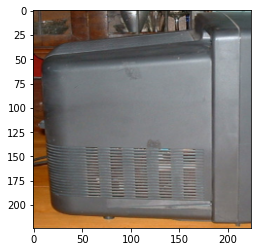

TV/monitor


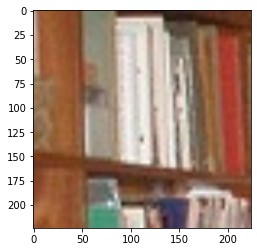

background


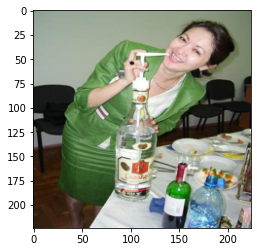

Person


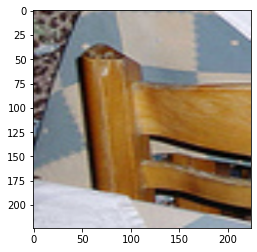

background


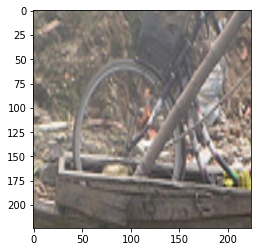

background


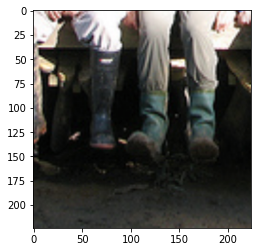

background


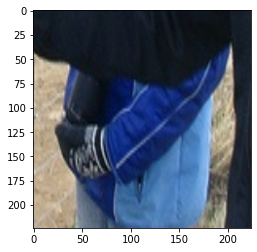

background


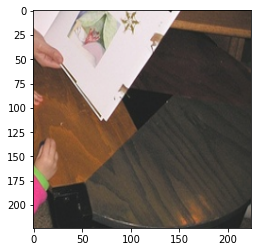

Dining table


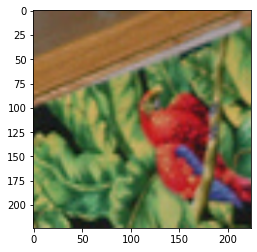

background


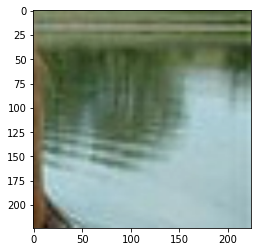

background


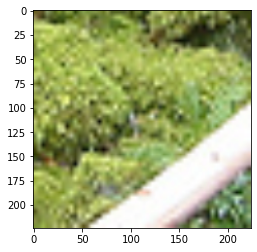

background


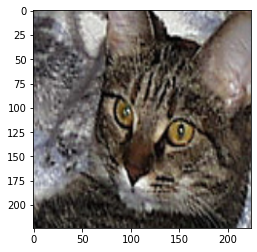

background


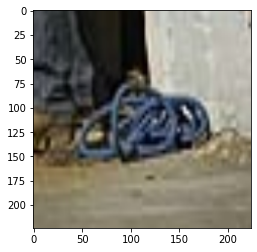

background


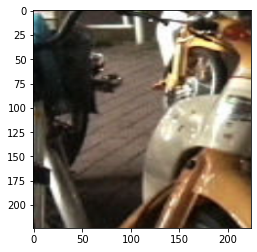

background


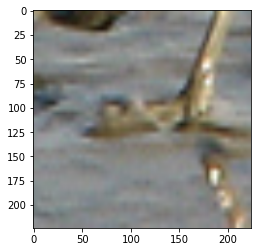

background


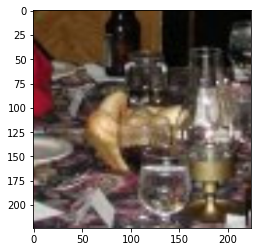

background


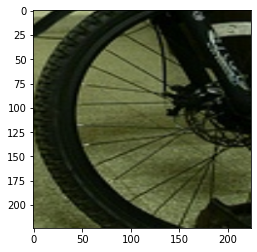

background


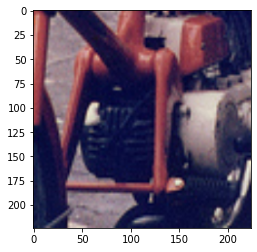

background


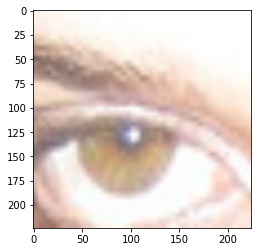

background


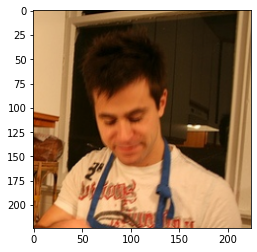

Person


In [ ]:
invTrans = transforms.Compose([ transforms.Normalize(mean = [ 0., 0., 0. ], std = [ 1/0.229, 1/0.224, 1/0.225 ]),
                                transforms.Normalize(mean = [ -0.485, -0.456, -0.406 ],std = [ 1., 1., 1. ]), 
                                transforms.ToPILImage() ])

for x in loader:
  
  for idx in range(20):
    plt.imshow(invTrans(x['image'][idx]))
    plt.show()
    print(voc_2012_classes[x['label'][idx]])

  break

### Object category classifier

In [ ]:
class RCNN_classifier_Dataset(torch.utils.data.Dataset):
  # https://pytorch.org/tutorials/beginner/data_loading_tutorial.html
  def __init__(self, dataset, cfg, IoU_threshold={'positive':0.5, 'partial':0.3}, sample_ratio=(32, 96),
              data_path='/content/drive/MyDrive/data/rcnn_ss/'):
    """
    Args:
        label_file (list of tuple(im path, label)): Path to image + annotations.
        im_root_dir (string): Directory with all the images.
        transform (callable, optional): Optional transform to be applied
            on a sample.
    """
    self.data_path = data_path
    self.dataset = dataset
    self.transform = transforms.Compose([ # preprocess image
        transforms.Resize((cfg['image_size'], cfg['image_size'])),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

    if self.dataset_exists()==False:
      self.generate_dataset(sample_ratio, IoU_threshold)
    else: 
      print('[*] Loading dataset from', self.data_path)
      with open(self.data_path + 'train_images_classifier.pkl', 'rb') as f:
        self.train_images=pickle.load(f)
      with open(self.data_path + 'train_labels_classifier.pkl', 'rb') as f:
        self.train_labels=pickle.load(f)

      # check if both files are complete, flawless
      if not len(self.train_images)==len(self.train_labels):
        raise ValueError('The loaded dataset is invalid (of different size).')

  def __len__(self):
    return len(self.train_labels)

  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()
    image=Image.fromarray(cv2.cvtColor(self.train_images[idx], cv2.COLOR_BGR2RGB))
    return  {'image': self.transform(image), 'label': self.train_labels[idx][0], 
             'est_bbox': self.train_labels[idx][1], 'gt_bbox': self.train_labels[idx][2]}
  '''
  # not working when interact too much w/ drive :(
  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()

    img_name = os.path.join(self.im_root_dir, self.label_file[idx][0])
    image = io.imread(img_name)
    if self.transform:
        image = self.transform(image)
    return  {'image': image, 'label': self.label_file[idx][1]}
  '''
  def dataset_exists(self):
    if os.path.exists(self.data_path+'train_images.pkl')==False:
      return False
    if os.path.exists(self.data_path + 'train_labels.pkl')==False:
      return False
    
    return True    

  def generate_dataset(self, sample_ratio, IoU_threshold, padding=16):
    #https://github.com/Hulkido/RCNN/blob/master/RCNN.ipynb

    image_dir=self.dataset.train_dir+'/JPEGImages/'
    annot_dir=self.dataset.train_dir+'/Annotations/'
    obj_counter = 0
    self.train_images=[]
    self.train_labels=[]

    print('[*] Generating dataset for R-CNN.')

    pbar = tqdm(sorted(os.listdir(image_dir)), position=0, leave=True) # only 2000 images :( <-------------
    
    for img_name in pbar:   
      pbar.set_description(f"Data size: {len(self.train_labels)}")
      
      # load image & gt bounding boxes 
      image = cv2.imread(image_dir + img_name)
      xml_path=annot_dir+img_name[:-4]+'.xml'
      gt_bboxes = self.dataset.read_xml(xml_path)

      # directly use gt bboxes as positive samples
      for gt_bbox in gt_bboxes:
        cropped = image[gt_bbox['y1']:gt_bbox['y2'], gt_bbox['x1']:gt_bbox['x2'], :]
        self.train_images.append(cropped)

        gt_bbox_xywh=((gt_bbox['x1'] + gt_bbox['x2']) / 2, (gt_bbox['y1'] + gt_bbox['y2']) / 2,
                           gt_bbox['x2']-gt_bbox['x1'], gt_bbox['y2']-gt_bbox['y1'])
        est_bbox_xywh = gt_bbox_xywh
        self.train_labels.append([gt_bbox['class'], est_bbox_xywh, gt_bbox_xywh])
      obj_counter += len(gt_bboxes)

      # time to collect background :)
      if obj_counter >= sample_ratio[0]:
        obj_counter -= sample_ratio[0]
        bg_counter = 0
        # generete bbox proposals via selective search
        rects = selective_search(image)[:2000]  # parse first 2000 boxes
        random.shuffle(rects)
        # loop through all ss bounding box proposals
        for (x, y, w, h) in rects:
          # apply padding
          x1, x2 = np.clip([x-padding, x+w+padding], 0, image.shape[1])
          y1, y2 = np.clip([y-padding, y+h+padding], 0, image.shape[0])
          bbox_est = {'x1':x1, 'y1':y1, 'x2':x2, 'y2':y2}
          is_object = False
          
          # check the proposal with every elements of the gt boxes
          for gt_bbox in gt_bboxes:
            iou = calculate_IoU(gt_bbox, bbox_est)
              
            if iou > IoU_threshold['partial']: # if object
              is_object=True
              break
          # save image
          if is_object==False:
            bg_counter+=1
            cropped = image[bbox_est['y1']:bbox_est['y2'], bbox_est['x1']:bbox_est['x2'], :]
            self.train_images.append(cropped)
            #cv2.imwrite(self.data_path+'train_images/'+str(image_count)+'.jpg', cropped) <-- too much drive I/O, timed out
            #image_count+=1
            est_bbox_xywh=(1.0, 1.0, 1.0, 1.0)
            gt_bbox_xywh=(1.0, 1.0, 1.0, 1.0)
            self.train_labels.append([0, est_bbox_xywh, gt_bbox_xywh])

          if bg_counter==sample_ratio[1]:  # control the ratio between 2 types
            break

        
    print('[*] Dataset generated! Saving labels to', self.data_path)
    with open(self.data_path + 'train_labels_classifier.pkl', 'wb') as f:
      pickle.dump(self.train_labels, f)
    with open(self.data_path + 'train_labels_classifier.pkl', 'wb') as f:
      pickle.dump(self.train_images, f)

In [ ]:
def RCNN_classifier_DatasetLoader(voc_dataset, cfg, training_cfg, shuffle=True):
  ds = RCNN_classifier_Dataset(voc_dataset, cfg)
  return torch.utils.data.DataLoader(ds, batch_size=training_cfg['batch_size'], shuffle=shuffle, num_workers=2)

In [ ]:
classifier_dataloader=RCNN_classifier_DatasetLoader(voc_dataset, config, train_config)    # `loader` is an instance of RCNN_dataset

[*] Generating dataset for R-CNN.


Data size: 99022:  76%|███████▌  | 9203/12125 [26:55<08:32,  5.70it/s]


ValueError: ignored

In [ ]:
invTrans = transforms.Compose([ transforms.Normalize(mean = [ 0., 0., 0. ], std = [ 1/0.229, 1/0.224, 1/0.225 ]),
                                transforms.Normalize(mean = [ -0.485, -0.456, -0.406 ],std = [ 1., 1., 1. ]), 
                                transforms.ToPILImage() ])

for x in classifier_dataloader:
  for idx in range(20):
    plt.imshow(invTrans(x['image'][idx]))
    plt.show()
    print(voc_2012_classes[x['label'][idx]])
  break

NameError: ignored

## Model

In [ ]:
def RCNN(cfg, load_path=None):
  if load_path:
    try:
      print('[*] Attempting to load model from:', load_path)
      loaded = torch.load(load_path)
    except: 
      print('[*] Model does not exist or is corrupted. Creating new model...')
      return _RCNN(cfg)

    # check whether `loaded` is an RCNN instance
    if loaded.__class__.__name__ == '_RCNN':
      return loaded
    else:
      raise ValueError('The loaded tensor is not an instance of _RCNN.')
  else:
    print('[*] Creating model...')
    return _RCNN(cfg)
    
class _RCNN(nn.Module):
  def __init__(self, cfg):
    super(_RCNN, self).__init__()
    self.num_classes = cfg['n_classes'] 
    self.dobbox_reg = cfg['bbox_reg']
    self.max_proposals = cfg['max_proposals'] # maximum number of regions to extract from given image at inference
    self.image_size = cfg['image_size'] # efficientnet-b0: 224

    if cfg['network']=='efficientnet-b0':
      self.initialize_weights()

  def inference(self, images, rgb=False, batch_size = 128, apply_nms=True, nms_threshold=0.2): 
    # when given single image
    if type(images) == np.ndarray and len(images.shape)==3: 
      return self.inference_single(images, rgb, batch_size, apply_nms)

    bboxes = []
    for image in tqdm(images, position=0): 
      pred_bboxes = self.inference_single(image, rgb, batch_size, apply_nms, silent_mode=True)
      bboxes.append(pred_bboxes)
    return bboxes

  def inference_single(self, image, rgb=False, batch_size = 128, apply_nms=True, nms_threshold=0.2, silent_mode = False): 
    # image must be loaded in BGR format(cv2.imread) or else rgb must be set to True
    # https://www.pyimagesearch.com/2020/07/13/r-cnn-object-detection-with-keras-tensorflow-and-deep-learning/
    self.eval()

    if rgb==True: # convert rgb to bgr for selective search
      image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    preprocess = transforms.Compose([ # preprocess image
      transforms.ToPILImage(),
      transforms.Resize((self.image_size, self.image_size)),
      transforms.ToTensor(),
      transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    # perferm selective search to find region proposals
    rects=selective_search(image)

    proposals=[]
    boxes=[]
    
    for (x, y, w, h) in rects[:self.max_proposals]:
      roi = cv2.cvtColor(image[y:y+h,x:x+w, :], cv2.COLOR_BGR2RGB)
      roi = preprocess(roi)

      proposals.append(roi)
      boxes.append({'x1':x, 'y1':y, 'x2':x + w, 'y2':y + h})

    # convert to DataLoader for batching
    proposals = torch.stack(proposals)
    proposals = torch.Tensor(proposals)
    proposals = torch.utils.data.TensorDataset(proposals)
    proposals = torch.utils.data.DataLoader(proposals, batch_size=batch_size)

    # predict probability of each box
    cnt = 0
    useful_bboxes = []
    for proposal_batch in tqdm(proposals, position= 0, disable = silent_mode):
      patches = proposal_batch[0].to(device)

      with torch.no_grad():
        features = self.convnet(patches)
        features = self.flatten(features)
        pred = self.classifier(features)
        pred = torch.nn.functional.softmax(pred)

        if self.dobbox_reg: 
          bbox_refine = self.bbox_reg(features)

      useful_idx = torch.where(pred.argmax(1)>0)  # patches which are not classified bg(0)
      for idx in useful_idx[0]: # loop through each image
        idx = idx.cpu().detach().numpy()
        estimate = {}

        class_prob = pred[idx].cpu().detach().numpy()
        estimate['class'] = class_prob.argmax(0)
        estimate['conf'] = class_prob.max(0)

        original_bbox = boxes[cnt * batch_size + idx]
        if self.dobbox_reg == False:
          estimate['bbox'] = original_bbox
        else: 
          estimate['bbox'] = self.refine_bbox(original_bbox, bbox_refine[idx])
        #print(estimate)
        useful_bboxes.append(estimate)
      cnt += 1

    # apply non-max suppression to remove duplicate boxes
    if apply_nms: 
      useful_bboxes = nms(useful_bboxes, nms_threshold)

    return useful_bboxes

  def refine_bbox(self, bbox, pred): 
      # refine bbox in list of [ {'x1', 'x2', 'y1', 'y2'}, ... ]
      # pred is array of predicted refinements of shape (batch size, 4)
      x, y = (bbox['x1'] + bbox['x2']) / 2, (bbox['y1'] + bbox['y2']) / 2
      w, h = bbox['x2'] - bbox['x1'], bbox['y2'] - bbox['y1']

      newx = x + w * pred[0]
      newy = y + h * pred[1]
      neww = w * torch.exp(pred[2])
      newh = h * torch.exp(pred[3])

      return {'x1': newx - neww/2, 'x2': newx + neww / 2, 'y1': newy - newh/2, 'y2': newy + newh / 2}

  def initialize_weights(self):
      print('[*] Initializing new network...')
      self.effnet = EfficientNet.from_pretrained('efficientnet-b0', num_classes=21).to(device)

      self.convnet = self.effnet.extract_features
      self.flatten = nn.Sequential(nn.AvgPool2d(7), nn.Flatten()).to(device)
      
      self.classifier = nn.Sequential(nn.Dropout(p=0.2, inplace=False), nn.Linear(1280, 21)).to(device)

      if self.dobbox_reg:
        self.bbox_reg = nn.Sequential(nn.Dropout(p=0.2, inplace=False), nn.Linear(1280, 4)).to(device)


## Training Loop

In [ ]:
class RCNN_Trainer():
  def __init__(self, model, loader, classifier_dataloader, validator=None):
    self.model=model
    self.loader=loader  
    self.classifier_dataloader = classifier_dataloader
    self.validator=validator

  def classifier_training(self, train_cfg): 
    if train_cfg['log_wandb']:
      wandb.init(project='rcnn_classifier', entity='krenerd77')
      wandb.watch(self.model.classifier, log_freq=100)

    cce = nn.CrossEntropyLoss()
    mse = nn.MSELoss()

    # Gradients for final classifier only
    optimizer = optim.Adam(self.model.classifier.parameters(), lr = train_cfg['lr'], weight_decay=train_cfg['l2_reg'])

    # initialize metrics
    if self.validator is not None: 
      self.validator.initialize(self.model, train_cfg['logging'])
    accuracy_counter = Accuracy()


    for epoch in range(train_cfg['epochs']): 
      self.model.train()  # set model to train mode
      print('[*] Training epoch',epoch + 1, '/',train_cfg['epochs'])
      pbar = tqdm(self.classifier_dataloader, position=0, leave=True)
      for step, data in enumerate(pbar):
        optimizer.zero_grad()
        # implement training step -------------------------
        # inference
        features = self.model.convnet(data['image'].to(device))
        features = self.model.flatten(features)
        output = self.model.classifier(features)
          
        # backprop
        clf_loss = cce(output, data['label'].to(device))
        loss = clf_loss

        loss.backward()
        optimizer.step()
        # logging ------------------------------------------
        acc = accuracy_counter(output.cpu(), data['label'])

        pbar.set_description(f"Loss: {str(loss.cpu().detach().numpy())[:5]}  Accuracy: {str(acc.numpy())[:5]}")

        if train_cfg['log_wandb'] and (step + 1) % 100==0:
          logdict = {}
          logdict['clf_loss'] = clf_loss
          logdict['accuracy'] = acc

          wandb.log(logdict)

      # save checkpoints and log
      torch.save(self.model, 'RCNN_checkpoint.pt')
      if self.validator is not None: 
        self.validator.validate() 

  def fine_tuning(self, train_cfg):
    if train_cfg['log_wandb']:
      wandb.init(project='rcnn', entity='krenerd77')
      wandb.watch(self.model, log_freq=100)

    cce = nn.CrossEntropyLoss()
    mse = nn.MSELoss()

    optimizer = optim.Adam(self.model.parameters(), lr = train_cfg['lr'], weight_decay=train_cfg['l2_reg'])

    # lr schedule
    if 'lr_decay' in train_cfg:
      lr_schedule = optim.lr_scheduler.ExponentialLR(optimizer, gamma=train_cfg['lr_decay'])
    else: # constant lr
      lr_schedule = optim.lr_scheduler.ExponentialLR(optimizer, gamma=1.0)

    # initialize metrics
    if self.validator is not None: 
      self.validator.initialize(self.model, train_cfg['logging'])
    accuracy_counter = Accuracy()


    for epoch in range(train_cfg['epochs']): 
      self.model.train()  # set model to train mode
      print('[*] Training epoch',epoch + 1, '/',train_cfg['epochs'])
      pbar = tqdm(self.loader, position=0, leave=True)
      for step, data in enumerate(pbar):
        optimizer.zero_grad()
        # implement training step -------------------------
        # inference
        features = self.model.convnet(data['image'].to(device))
        features = self.model.flatten(features)
        output = self.model.classifier(features)
        # backprop
        clf_loss = cce(output, data['label'].to(device))
        loss = clf_loss
        # bbox regression loss
        if self.model.dobbox_reg == True:
          bbox_est = self.model.bbox_reg(features)
          # regression targets are described in Appendix C. 
          p_x, p_y, p_w, p_h = data['est_bbox'][0], data['est_bbox'][1], data['est_bbox'][2], data['est_bbox'][3]
          g_x, g_y, g_w, g_h = data['gt_bbox'][0], data['gt_bbox'][1], data['gt_bbox'][2], data['gt_bbox'][3]

          bbox_ans = torch.stack([(g_x - p_x) / p_w, (g_y - p_y) / p_h, torch.log(g_w) / p_w, torch.log(g_h) / p_h], axis = 1)
          bbox_ans = bbox_ans.float().to(device)

          # count only images that are not background
          not_bg = (data['label']>0).reshape(len(data['label']), 1).to(device)  # mask about whether each image is a background
          bbox_est = bbox_est * not_bg
          bbox_ans = bbox_ans * not_bg

          # add to loss    
          bbox_loss = mse(bbox_est, bbox_ans)
          loss += bbox_loss
          
        loss.backward()
        optimizer.step()
        # logging ------------------------------------------
        acc = accuracy_counter(output.cpu(), data['label'])

        pbar.set_description(f"Loss: {str(loss.cpu().detach().numpy())[:5]}  Accuracy: {str(acc.numpy())[:5]}")

        if train_cfg['log_wandb'] and (step + 1) % 100==0:
          logdict = {}
          logdict['clf_loss'] = clf_loss
          logdict['accuracy'] = acc

          if self.model.dobbox_reg==True:
            logdict['bbox_loss'] = bbox_loss
          
          wandb.log(logdict)

      # update lr
      lr_schedule.step()
      # save checkpoints and log
      torch.save(self.model, 'RCNN_checkpoint.pt')
      if self.validator is not None: 
        self.validator.validate() 


# Validation

In [ ]:
class ValDataset(torch.utils.data.Dataset):
  # https://pytorch.org/tutorials/beginner/data_loading_tutorial.html
  def __init__(self, dataset):
    self.base_dir = dataset.test_dir
    self.dataset = dataset
    self.images = sorted(os.listdir(dataset.test_dir+'/JPEGImages/'))

  def __len__(self):
    return len(self.images)

  def __getitem__(self, idx):
    if torch.is_tensor(idx):
        idx = idx.tolist()

    image_path = self.base_dir + '/JPEGImages/' + self.images[idx]
    image = cv2.imread(image_path)

    xml_path = self.base_dir + '/Annotations/' + self.images[idx][:-4]+'.xml'
    gt_bboxes = self.dataset.read_xml(xml_path) # load bboxes in list of dicts {x1, x2, y1, y2, class}

    return  {'image': image, 'label': gt_bboxes}

In [ ]:
val_dataset = ValDataset(voc_dataset)

In [ ]:
class PlotSamples():
  def __init__(self, to_sample=10):
    # create table for plotting 
    self.to_sample = to_sample
    self.images = []

  def log(self, model, val_dataset):
    print('[*] Plotting samples to wandb board...')
    sampled = []
    for x in range(self.to_sample):
      img=val_dataset[x]['image']
      bboxes=model.inference(img)

      result_image = plot_results(img, bboxes)

      result_image = cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB)
      sampled.append(wandb.Image(result_image))

    self.images.append(sampled)
    # write to table
    sample_columns = ['sample '+str(x+1) for x in range(self.to_sample)]
    sample_table = wandb.Table(columns=sample_columns)

    for step_image in self.images:
      sample_table.add_data(*step_image)
    wandb.run.log({"Samples_table" : sample_table})

class ComputeMAP():
  def __init__(self, iou_threshold=0.5):
    # create table for plotting 
    self.iou_threshold = iou_threshold
    self.sample_table = wandb.Table(columns=voc_2012_classes)

  def log(self, model, val_dataset):
    return 0
    val_images = sorted(os.listdir(image_path))
    
    sampled = []
    for x in range(to_sample):
      img=cv2.imread(image_path+val_images[x]+'.jpg')
      bboxes=model.inference(img)

      result_image = plot_results(img, bboxes)
      sampled.append(result_image)
    return sampled

In [ ]:
class Validator():
  def __init__(self, val_dataset):
    self.val_dataset = val_dataset

  def initialize(self, model, log_keys): 
    self.model = model 

    self.loggers = {}
    self.log_keys = log_keys
    log_funcs = {'map': ComputeMAP, 'plot': PlotSamples}
    for logtype in log_keys: 
      self.loggers[logtype] = log_funcs[logtype]()

  def validate(self):
    self.model.eval()
    for key in self.log_keys:
      self.loggers[key].log(model, self.val_dataset)

# Train & Evaluate Network

In [ ]:
model=RCNN(config, load_path = 'RCNN_checkpoint.pt').to(device) # 'RCNN_checkpoint.pt'
validator=Validator(val_dataset)

[*] Attempting to load model from: RCNN_checkpoint.pt


In [ ]:
trainer=RCNN_Trainer(model, loader, None, validator)
trainer.fine_tuning(train_config)

[*] Training epoch 1 / 3


Loss: 0.201  Accuracy: 0.938: 100%|██████████| 2067/2067 [21:16<00:00,  1.62it/s]


[*] Plotting samples to wandb board...


100%|██████████| 11/11 [00:01<00:00,  6.39it/s]


[*] Training epoch 2 / 3


Loss: 0.088  Accuracy: 0.958: 100%|██████████| 2067/2067 [21:37<00:00,  1.59it/s]


[*] Plotting samples to wandb board...


100%|██████████| 11/11 [00:01<00:00,  6.40it/s]


[*] Training epoch 3 / 3


Loss: 0.054  Accuracy: 0.979: 100%|██████████| 2067/2067 [21:45<00:00,  1.58it/s]


[*] Plotting samples to wandb board...


100%|██████████| 11/11 [00:01<00:00,  6.41it/s]


In [ ]:
trainer=RCNN_Trainer(model, None, classification_loader, validator)
trainer.classifier_training(train_config)

In [ ]:
from google.colab import files
files.download('RCNN_checkpoint.pt') 

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
def read_xml(xml_path):
  # referenced code of https://deepbaksuvision.github.io/Modu_ObjectDetection/posts/02_01_PASCAL_VOC.html
  tree = ET.parse(open(xml_path, 'r'))

  root=tree.getroot()

  obj_list = []
  objects = root.findall("object")
  for _object in objects:
    name = _object.find("name").text
    bndbox = _object.find("bndbox")
    xmin = int(bndbox.find("xmin").text)
    ymin = int(bndbox.find("ymin").text)
    xmax = int(bndbox.find("xmax").text)
    ymax = int(bndbox.find("ymax").text)
    class_name = _object.find('name').text
    
    obj_list.append({'class': voc_dataset.convert_labels[class_name], 'conf': 1.0, 
                     'bbox': {'x1':xmin, 'x2':xmax, 'y1':ymin, 'y2':ymax}})
  return obj_list

Estimate:


100%|██████████| 8/8 [00:01<00:00,  6.92it/s]


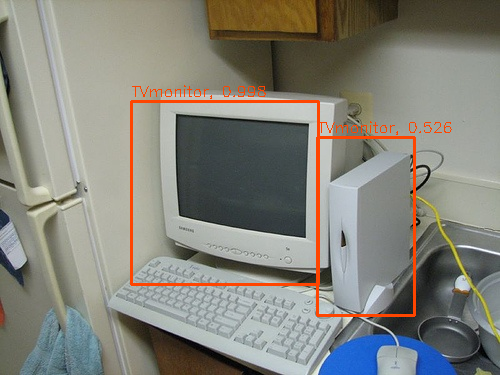

Ground truth:


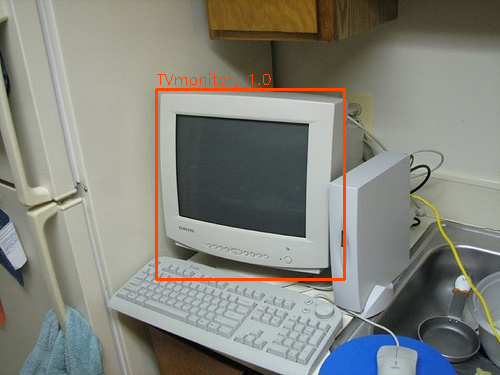

Estimate:


100%|██████████| 10/10 [00:01<00:00,  6.56it/s]


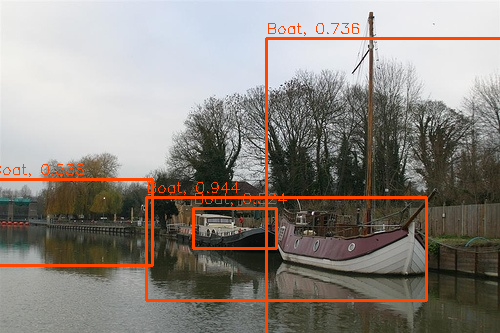

Ground truth:


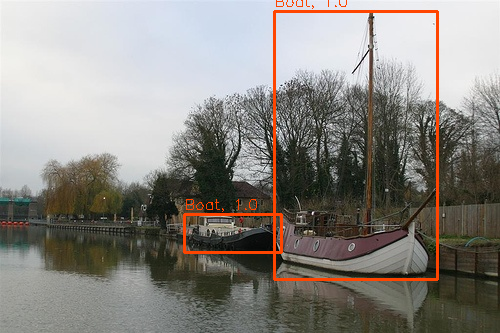

Estimate:


100%|██████████| 11/11 [00:01<00:00,  6.36it/s]


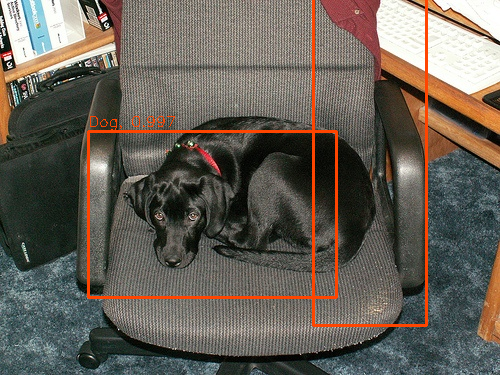

Ground truth:


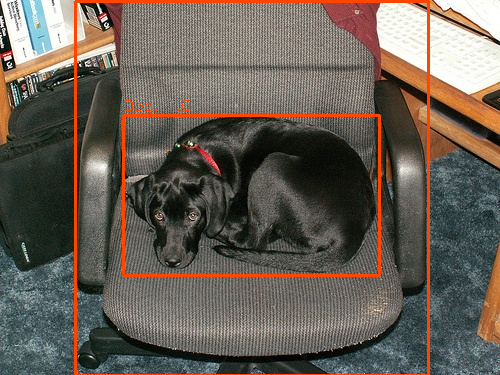

Estimate:


100%|██████████| 15/15 [00:02<00:00,  6.22it/s]


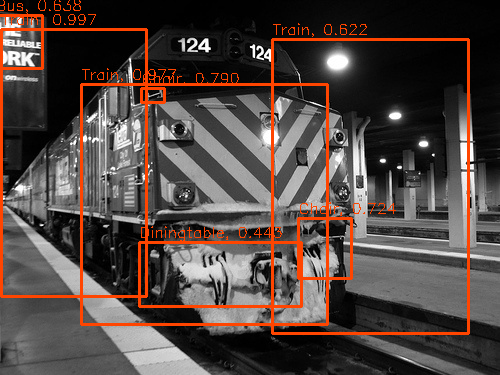

Ground truth:


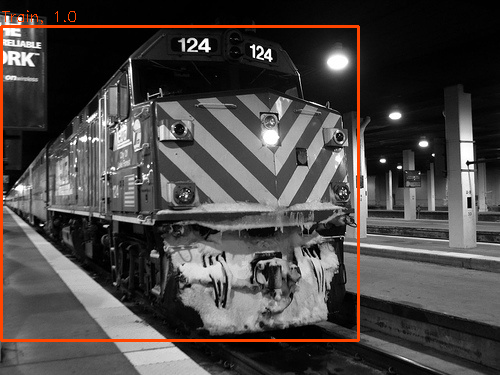

Estimate:


100%|██████████| 13/13 [00:02<00:00,  6.02it/s]


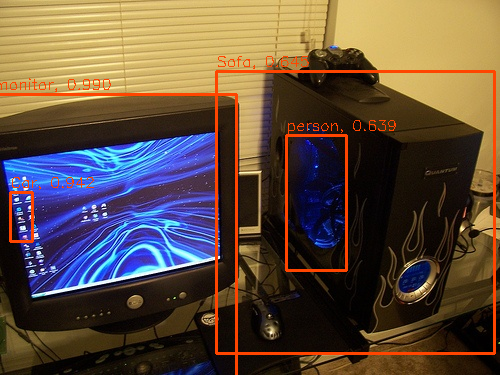

Ground truth:


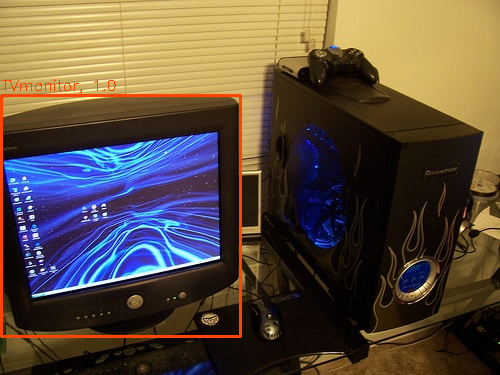

Estimate:


100%|██████████| 13/13 [00:02<00:00,  6.41it/s]


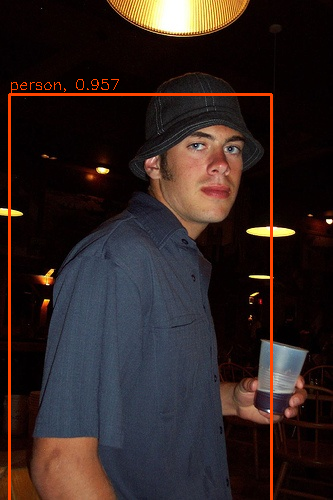

Ground truth:


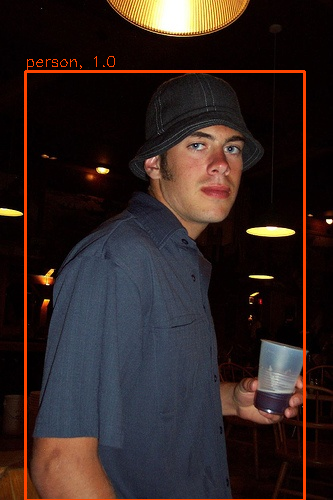

Estimate:


100%|██████████| 11/11 [00:01<00:00,  6.30it/s]


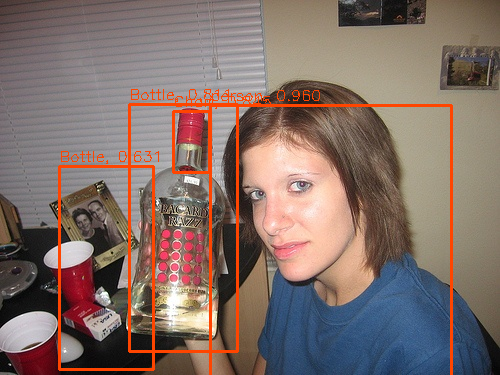

Ground truth:


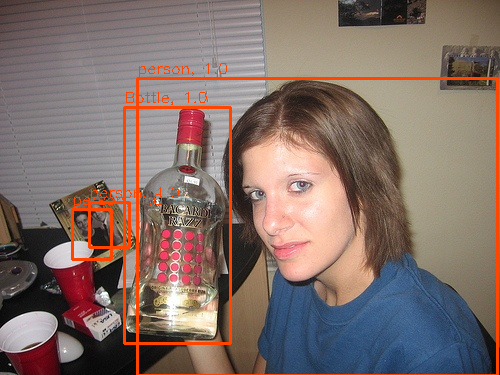

Estimate:


100%|██████████| 6/6 [00:01<00:00,  5.98it/s]


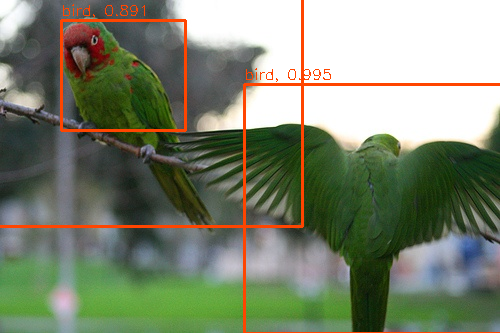

Ground truth:


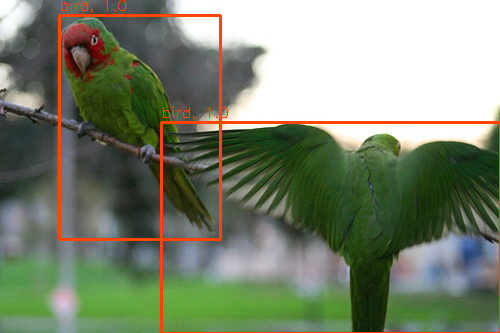

Estimate:


100%|██████████| 10/10 [00:01<00:00,  6.41it/s]


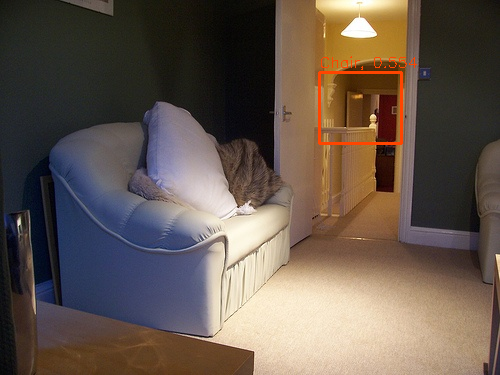

Ground truth:


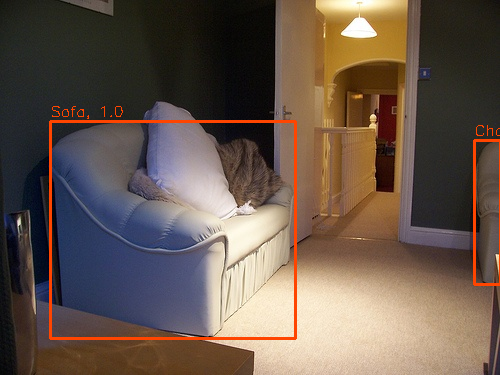

Estimate:


100%|██████████| 11/11 [00:01<00:00,  6.29it/s]


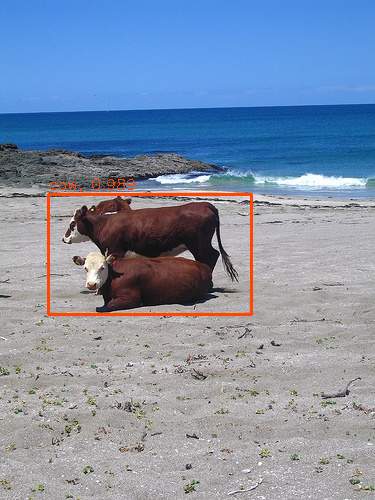

Ground truth:


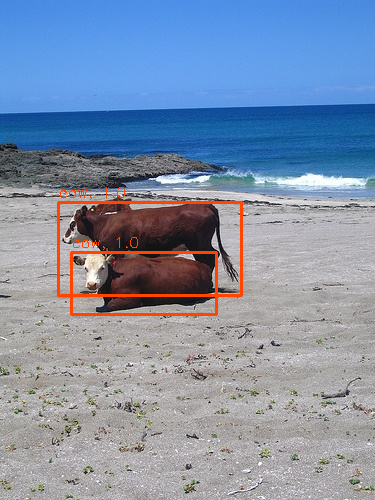

In [ ]:
for idx in range(10):
  img_name = sorted(os.listdir(voc_dataset.test_dir+'/JPEGImages'))[idx][:-4]

  img=cv2.imread(voc_dataset.test_dir+'/JPEGImages/'+img_name+'.jpg')
  
  print('Estimate:')
  bboxes=model.inference(img, nms_threshold=0.2)
  bboxes=nms(bboxes, 0.2)
  res=plot_results(img, bboxes)
  cv2_imshow(res)

  print('Ground truth:')
  gt_bboxes = read_xml(voc_dataset.test_dir+'/Annotations/'+img_name+'.xml')
  res=plot_results(img, gt_bboxes)
  cv2_imshow(res)
  


Estimate:


100%|██████████| 10/10 [00:01<00:00,  6.32it/s]


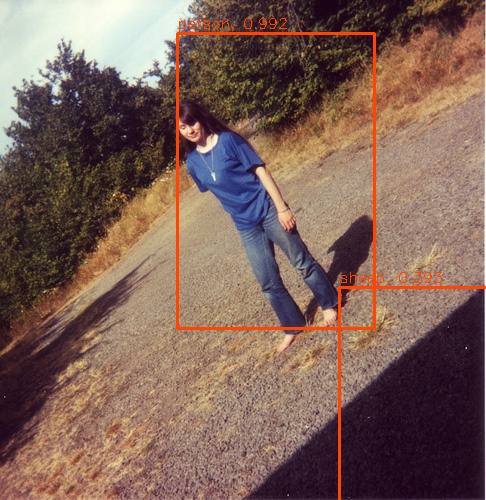

Ground truth:


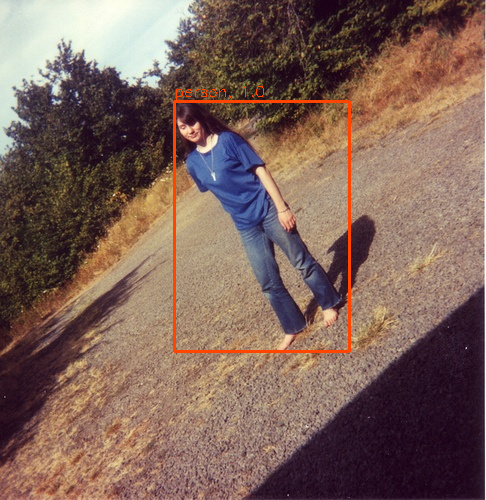

Estimate:


100%|██████████| 8/8 [00:01<00:00,  6.50it/s]


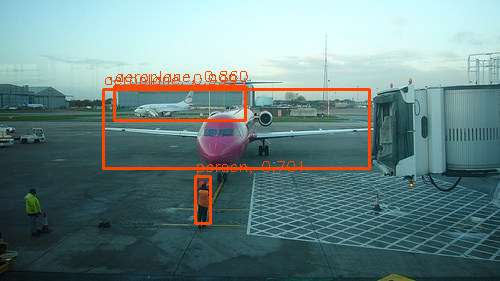

Ground truth:


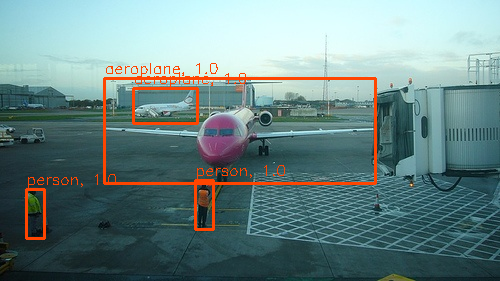

Estimate:


100%|██████████| 15/15 [00:02<00:00,  6.25it/s]


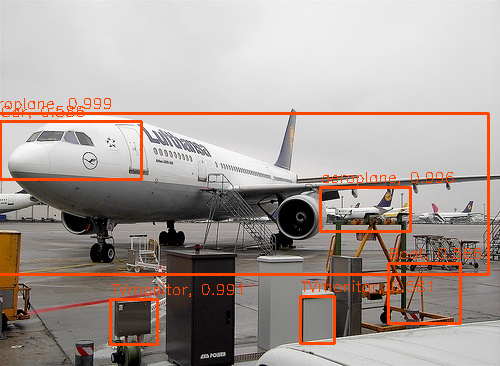

Ground truth:


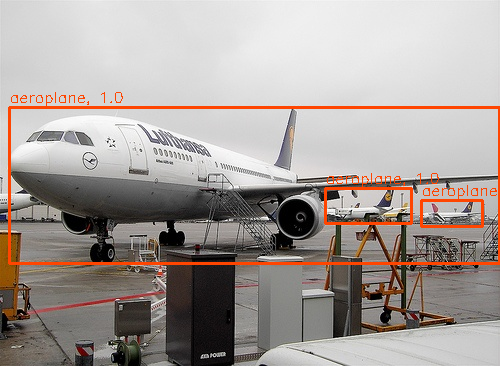

Estimate:


100%|██████████| 16/16 [00:02<00:00,  6.14it/s]


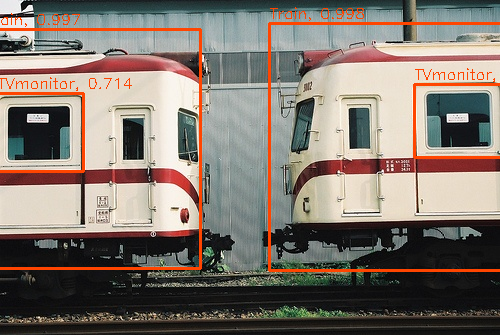

Ground truth:


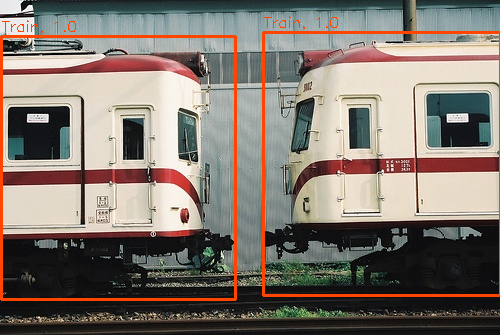

Estimate:


100%|██████████| 8/8 [00:01<00:00,  6.56it/s]


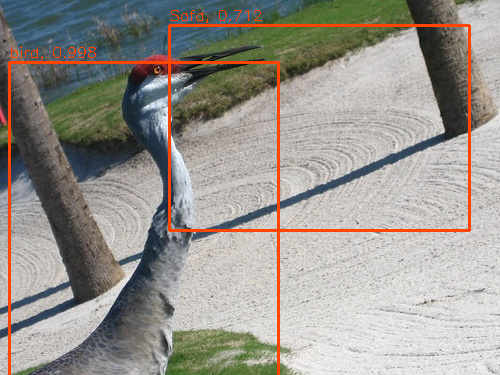

Ground truth:


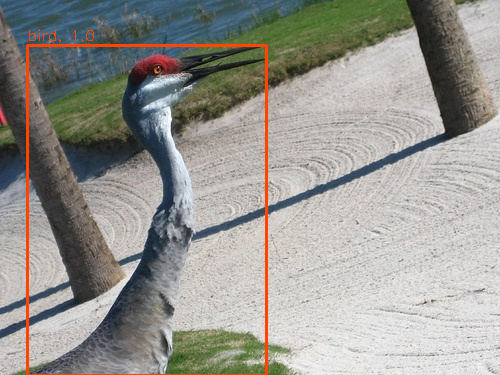

Estimate:


100%|██████████| 11/11 [00:01<00:00,  6.34it/s]


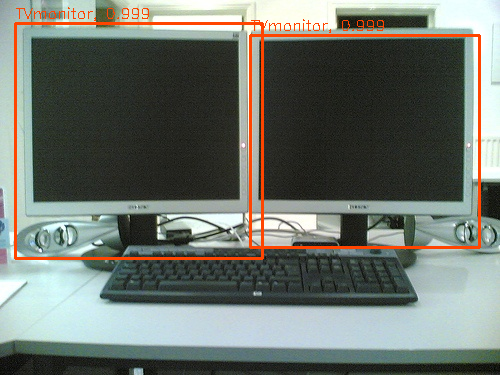

Ground truth:


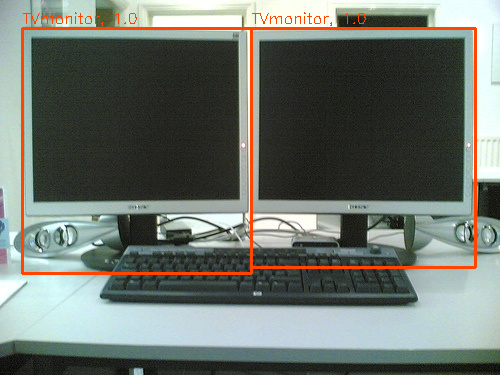

Estimate:


100%|██████████| 16/16 [00:02<00:00,  6.05it/s]


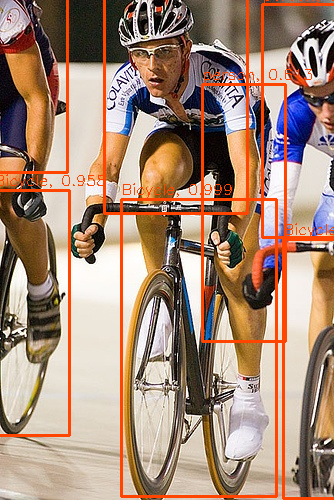

Ground truth:


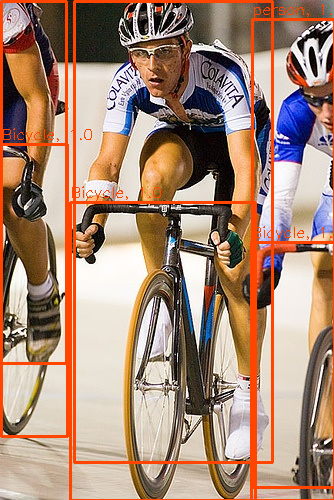

Estimate:


100%|██████████| 15/15 [00:02<00:00,  6.21it/s]


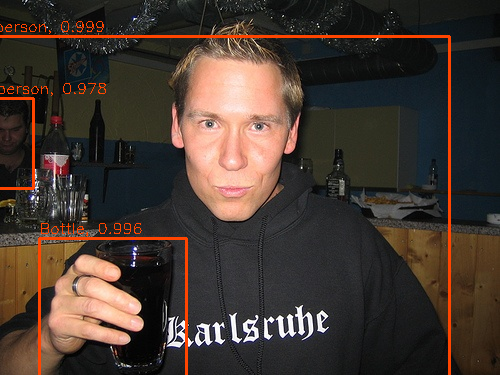

Ground truth:


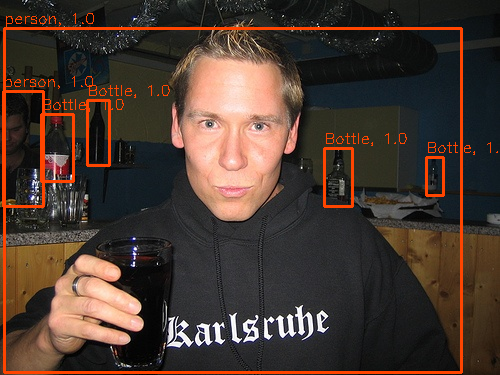

Estimate:


100%|██████████| 10/10 [00:01<00:00,  6.29it/s]


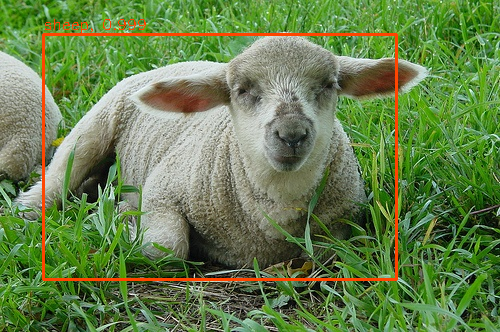

Ground truth:


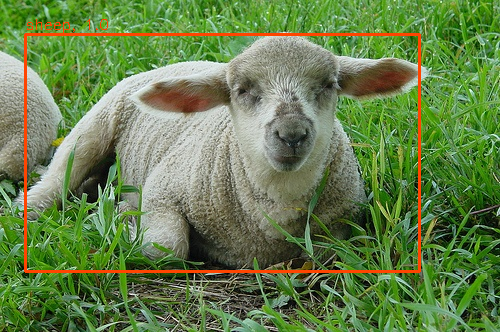

Estimate:


100%|██████████| 6/6 [00:00<00:00,  6.91it/s]


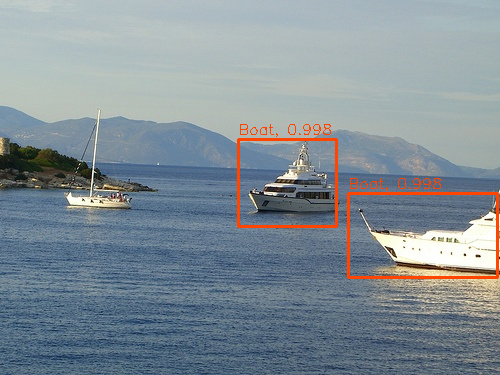

Ground truth:


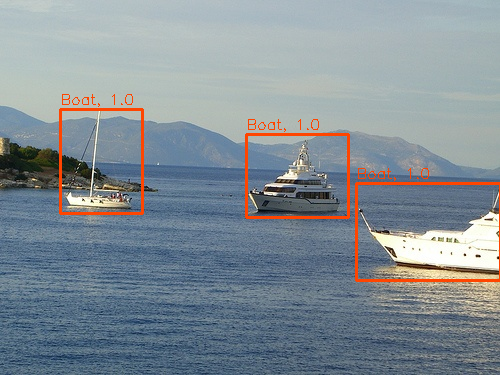

In [ ]:
for idx in range(10):
  img_name = sorted(os.listdir(voc_dataset.train_dir+'/JPEGImages'))[idx][:-4]

  img=cv2.imread(voc_dataset.train_dir+'/JPEGImages/'+img_name+'.jpg')

  print('Estimate:')
  bboxes=model.inference(img, nms_threshold=0.2)

  res=plot_results(img, bboxes)
  cv2_imshow(res)

  print('Ground truth:')
  gt_bboxes = read_xml(voc_dataset.train_dir+'/Annotations/'+img_name+'.xml')
  res=plot_results(img, gt_bboxes)
  cv2_imshow(res)


Estimate:


100%|██████████| 10/10 [00:01<00:00,  6.35it/s]


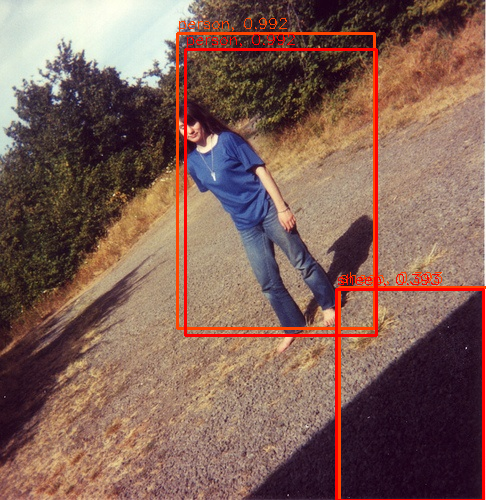

Ground truth:


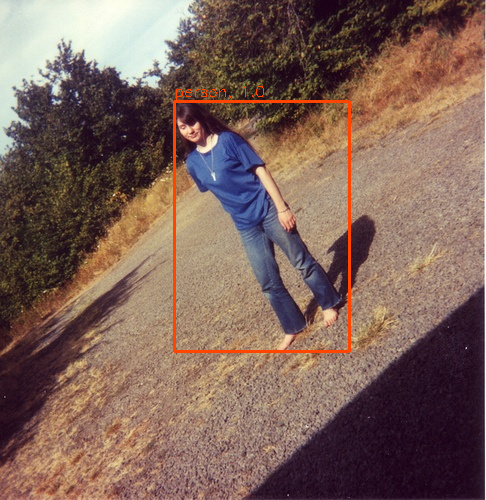

Estimate:


100%|██████████| 8/8 [00:01<00:00,  6.61it/s]


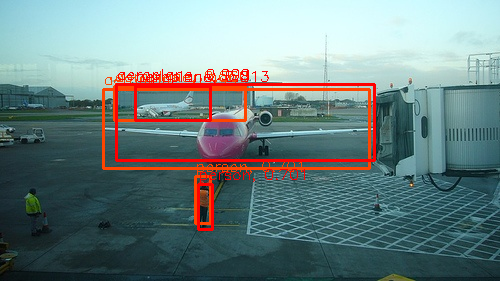

Ground truth:


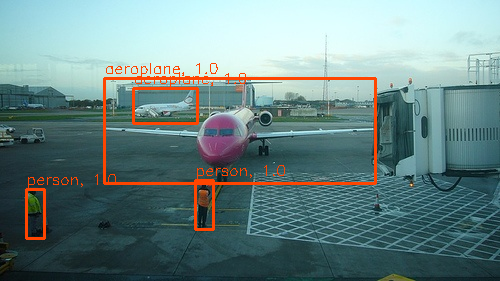

Estimate:


100%|██████████| 15/15 [00:02<00:00,  6.38it/s]


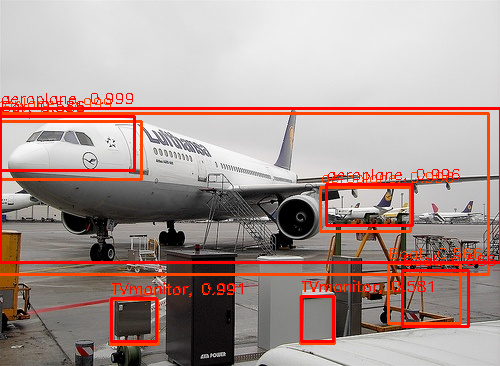

Ground truth:


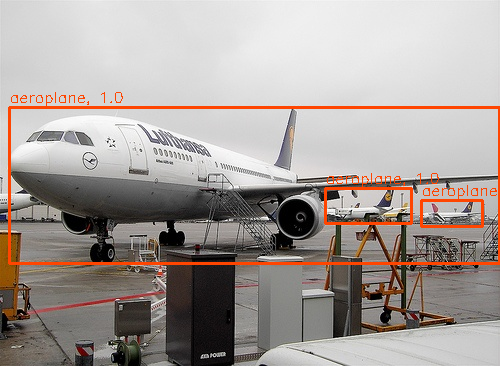

Estimate:


100%|██████████| 16/16 [00:02<00:00,  6.19it/s]


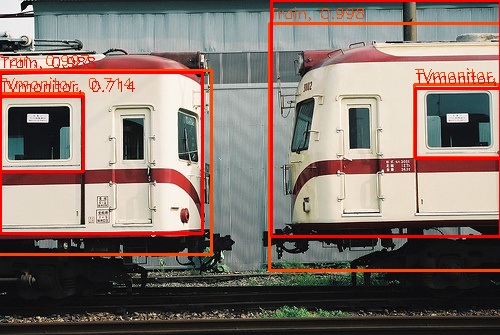

Ground truth:


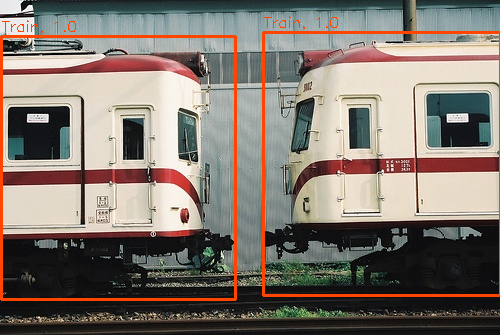

Estimate:


100%|██████████| 8/8 [00:01<00:00,  6.56it/s]


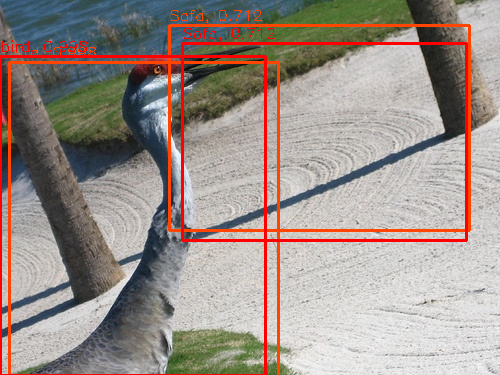

Ground truth:


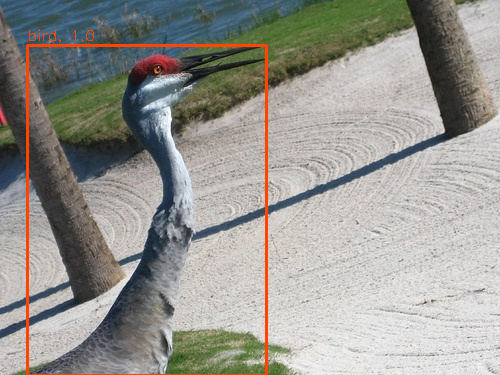

Estimate:


100%|██████████| 11/11 [00:01<00:00,  6.48it/s]


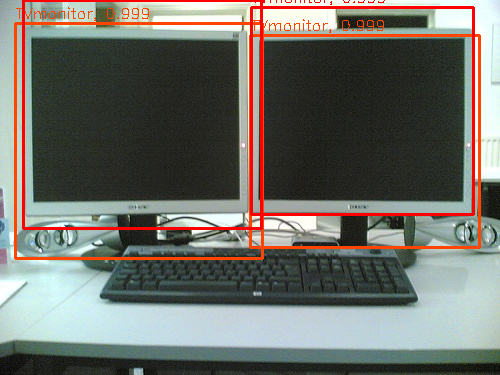

Ground truth:


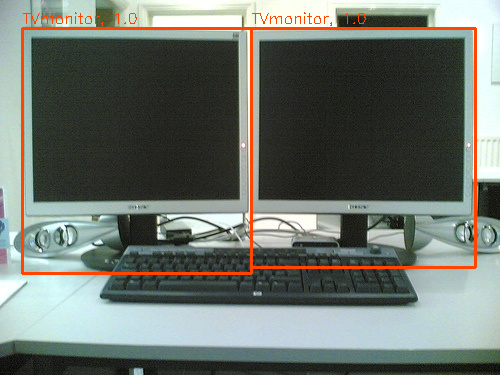

Estimate:


100%|██████████| 16/16 [00:02<00:00,  6.17it/s]


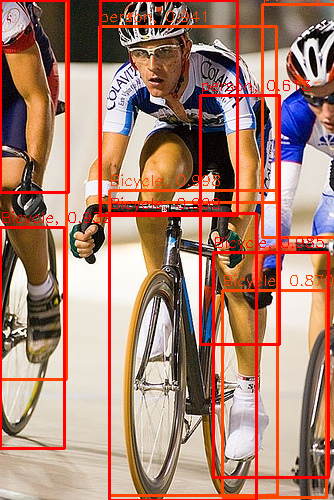

Ground truth:


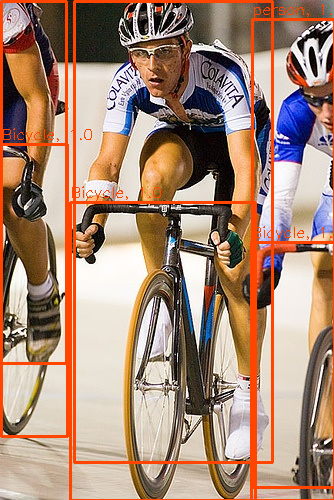

Estimate:


100%|██████████| 15/15 [00:02<00:00,  6.25it/s]


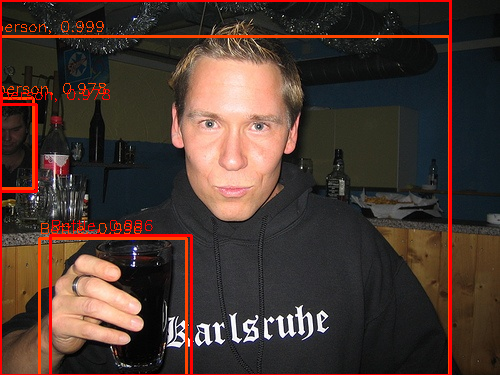

Ground truth:


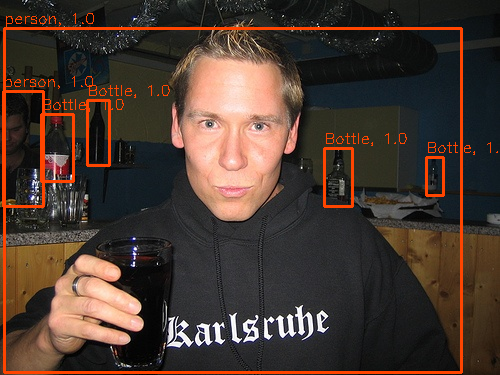

Estimate:


100%|██████████| 10/10 [00:01<00:00,  6.38it/s]


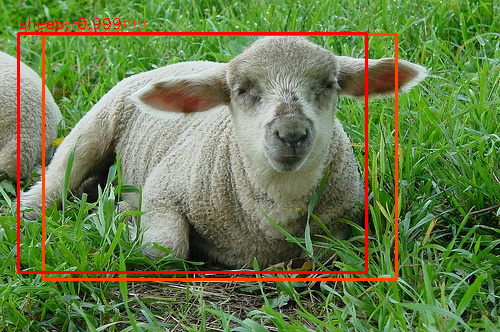

Ground truth:


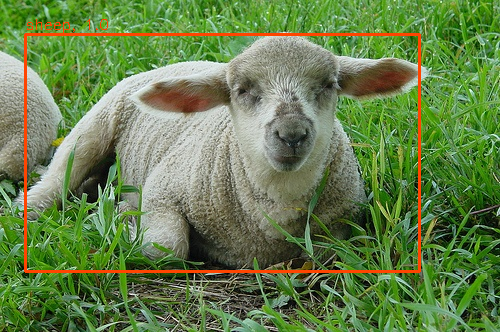

Estimate:


100%|██████████| 6/6 [00:00<00:00,  6.94it/s]


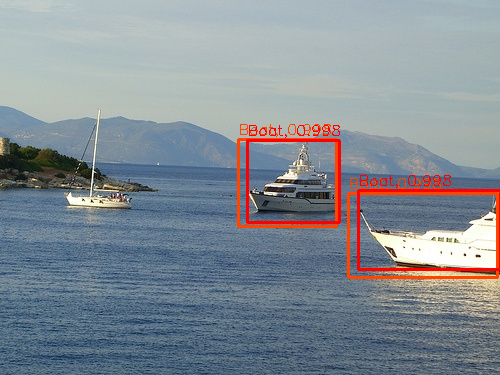

Ground truth:


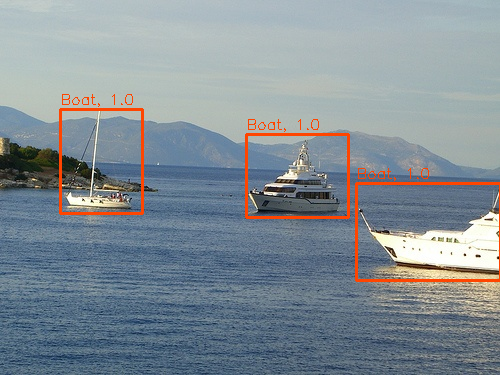

In [ ]:
for idx in range(10):
  img_name = sorted(os.listdir(voc_dataset.train_dir+'/JPEGImages'))[idx][:-4]

  img=cv2.imread(voc_dataset.train_dir+'/JPEGImages/'+img_name+'.jpg')

  print('Estimate:')
  model.dobbox_reg = True
  bboxes=model.inference(img, nms_threshold=0.2)
  bboxes=nms(bboxes, 0.2)

  model.dobbox_reg = False
  bboxes2=model.inference(img, nms_threshold=0.2)
  bboxes2=nms(bboxes2, 0.2)

  res=plot_results(img, bboxes)
  res=plot_results(res, bboxes2, (0,0,255))
  cv2_imshow(res)

  print('Ground truth:')
  gt_bboxes = read_xml(voc_dataset.train_dir+'/Annotations/'+img_name+'.xml')
  res=plot_results(img, gt_bboxes)
  cv2_imshow(res)

model.dobbox_reg = True

Estimate:


100%|██████████| 10/10 [00:01<00:00,  6.24it/s]


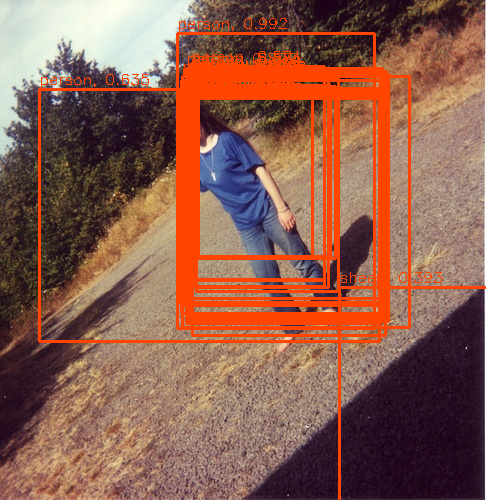

Ground truth:


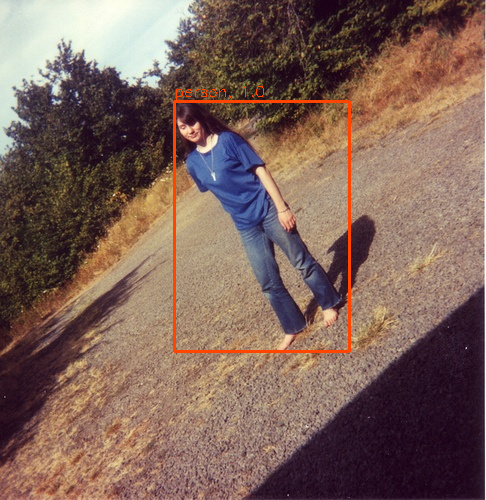

Estimate:


100%|██████████| 8/8 [00:01<00:00,  6.56it/s]


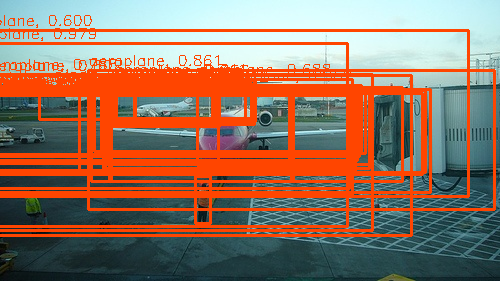

Ground truth:


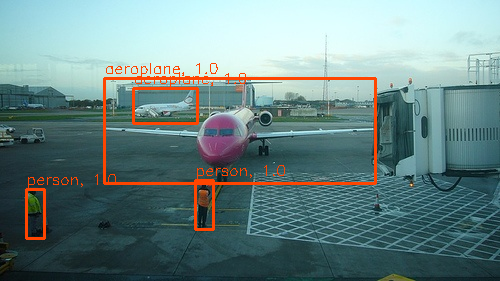

Estimate:


100%|██████████| 15/15 [00:02<00:00,  6.27it/s]


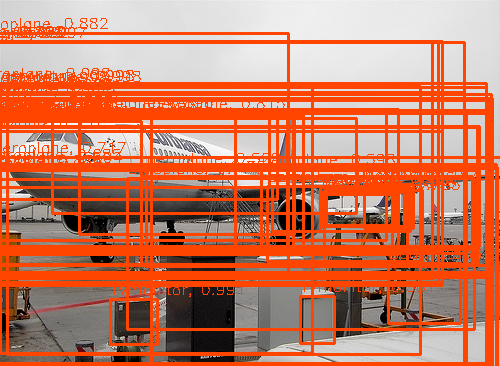

Ground truth:


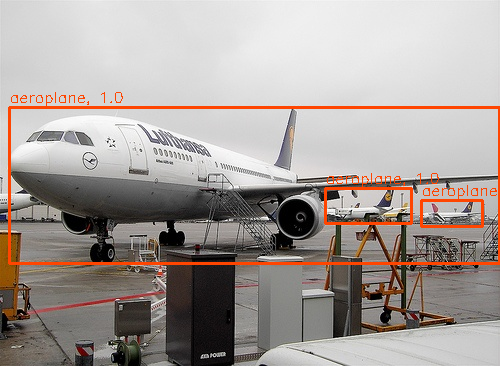

Estimate:


100%|██████████| 16/16 [00:02<00:00,  6.08it/s]


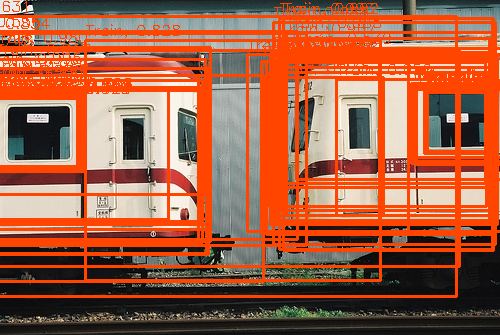

Ground truth:


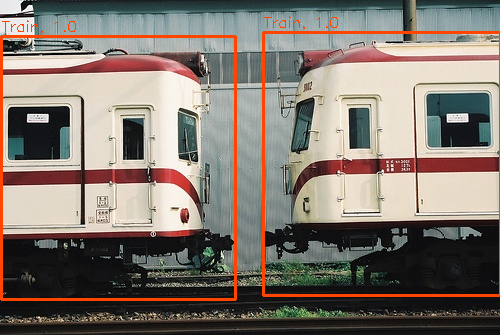

Estimate:


100%|██████████| 8/8 [00:01<00:00,  6.48it/s]


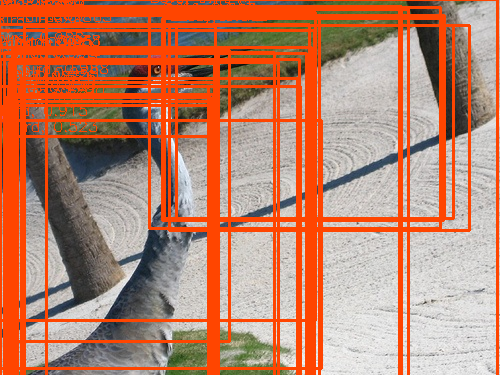

Ground truth:


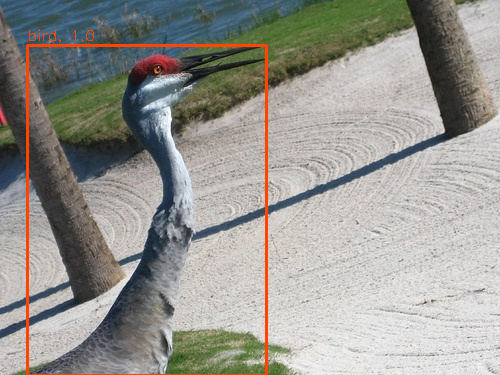

Estimate:


100%|██████████| 11/11 [00:01<00:00,  6.38it/s]


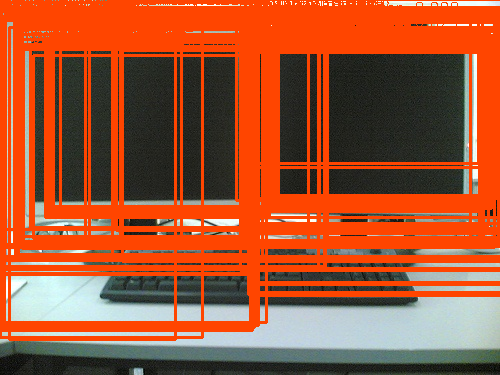

Ground truth:


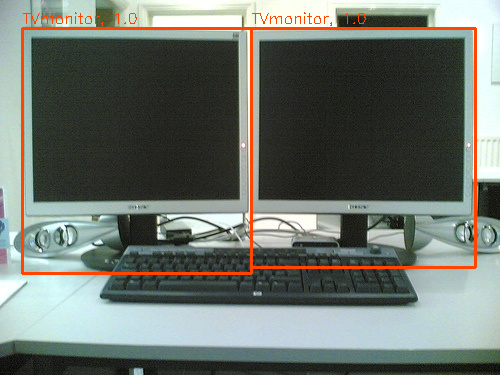

Estimate:


100%|██████████| 16/16 [00:02<00:00,  6.08it/s]


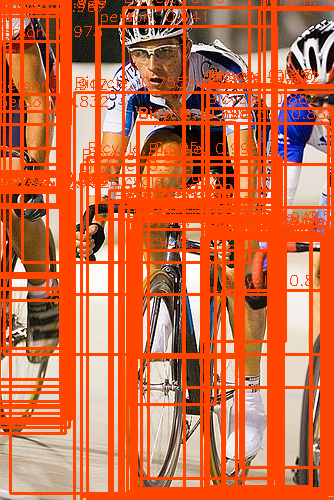

Ground truth:


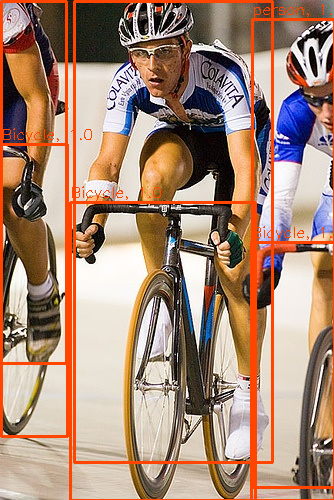

Estimate:


100%|██████████| 15/15 [00:02<00:00,  6.16it/s]


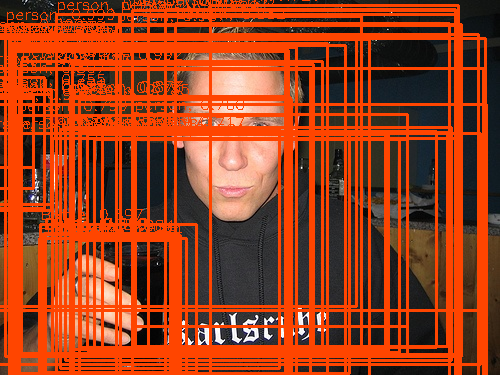

Ground truth:


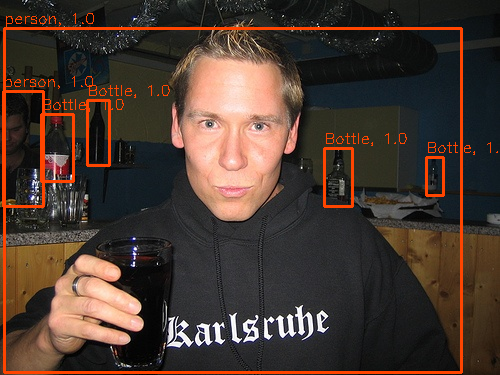

Estimate:


100%|██████████| 10/10 [00:01<00:00,  6.27it/s]


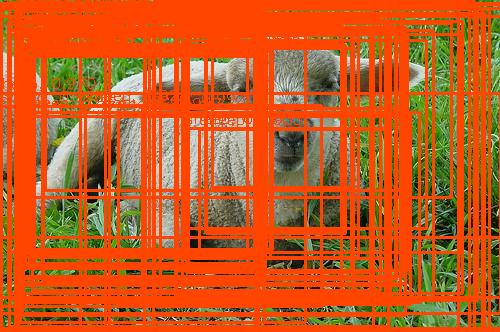

Ground truth:


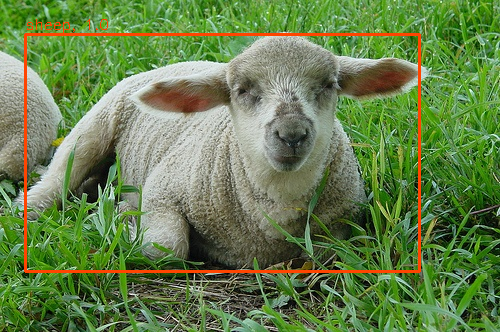

Estimate:


100%|██████████| 6/6 [00:00<00:00,  6.89it/s]


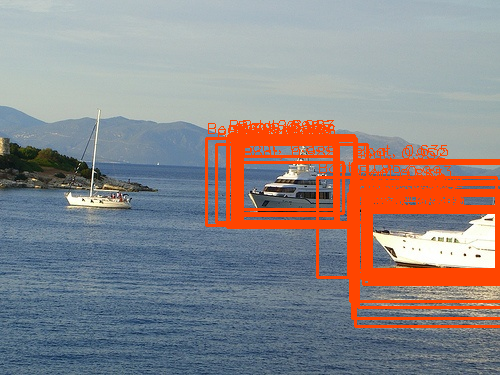

Ground truth:


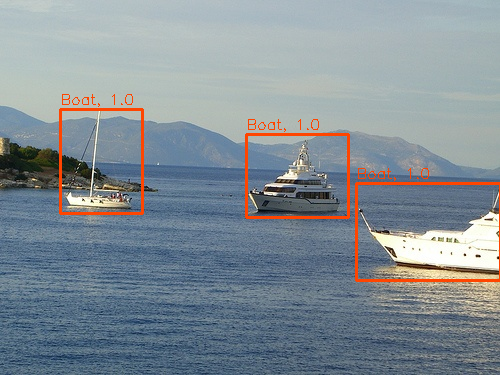

In [ ]:
for idx in range(10):
  img_name = sorted(os.listdir(voc_dataset.train_dir+'/JPEGImages'))[idx][:-4]

  img=cv2.imread(voc_dataset.train_dir+'/JPEGImages/'+img_name+'.jpg')

  print('Estimate:')
  bboxes=model.inference(img,apply_nms=False)

  res=plot_results(img, bboxes)
  cv2_imshow(res)

  print('Ground truth:')
  gt_bboxes = read_xml(voc_dataset.train_dir+'/Annotations/'+img_name+'.xml')
  res=plot_results(img, gt_bboxes)
  cv2_imshow(res)


In [ ]:
bboxes_nms = nms(bboxes, 0.2)
plot_results(img, bboxes_nms)

In [ ]:
# referenced from https://github.com/Hulkido/RCNN/blob/master/RCNN.ipynb
img_ss=img.copy()

for x in ds:

  x1, y1, x2, y2 = x['bbox']
  cv2.rectangle(img_ss, (x1, y1), (x2, y2), (100, 255, 100), 1)
  cv2.putText(img_ss, f"{voc_dataset.label_type[x['class']]}+{x['conf']}",  (x1, y1-5), font, 
    fontScale,
    fontColor,
    lineType)
cv2_imshow(img_ss)

In [ ]:
ds

In [ ]:
for proposal_batch in tqdm(proposals_dataset, position= 0):
      print(proposal_batch[0])
      features = model.convnet(proposal_batch[0])
      pred = model.classifier(features)
      print(pred.argmax(0))
      input()

In [ ]:
plt.imshow(cv2.cvtColor(img, cv2.COLOR_RGB2BGR))

In [ ]:
trainer.fine_tuning(train_config)

In [ ]:
from google.colab import files
files.download('RCNN_checkpoint.pt')


In [ ]:
img.shape

In [ ]:
t = transforms.Compose([ # preprocess image
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])

In [ ]:
t(img).shape

In [ ]:
torch.Tensor([[1,2], [2,3], [4, 5]])